<a href="https://colab.research.google.com/github/xeonqq/FourierFeatureSiren/blob/main/ffn_vs_siren_and_combined.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Fourier Feature Network(FFN) VS Siren, can we combine them?

This is a colab to compare the performace of [Fourier Feature Network(FFN)](https://bmild.github.io/fourfeat/) and Siren MLP, proposed in work [Implicit Neural Activations with Periodic Activation Functions](https://vsitzmann.github.io/siren). In terms of accuracy in image fitting.

In the end, a combined version of FFN and Siren (FFNSiren) is presented, which shows the best performace.


* The Siren implementation is a copy-paste from the original implementation from the author

* FFN implementation is a pytorch port from the original jax implemenation from the author. (But removing the last sigmoid layer from the original network) 

In [5]:
import torch
from torch import nn
import torch.nn.functional as F
from torch.utils.data import DataLoader, Dataset
import os

from PIL import Image
from torchvision.transforms import Resize, Compose, ToTensor, Normalize
import numpy as np
import skimage
import matplotlib.pyplot as plt

import time
device = 'cuda' if torch.cuda.is_available() else 'cpu'

def get_mgrid(sidelen, dim=2):
    '''Generates a flattened grid of (x,y,...) coordinates in a range of -1 to 1.
    sidelen: int
    dim: int'''
    tensors = tuple(dim * [torch.linspace(-1, 1, steps=sidelen)])
    mgrid = torch.stack(torch.meshgrid(*tensors), dim=-1)
    mgrid = mgrid.reshape(-1, dim)
    return mgrid

In [6]:
print(device)

cuda


In [7]:
torch.manual_seed(0)

Now, we code up the sine layer, which will be the basic building block of SIREN. This is a much more concise implementation than the one in the main code, as here, we aren't concerned with the baseline comparisons.

In [8]:
class SineLayer(nn.Module):
    # See paper sec. 3.2, final paragraph, and supplement Sec. 1.5 for discussion of omega_0.
    
    # If is_first=True, omega_0 is a frequency factor which simply multiplies the activations before the 
    # nonlinearity. Different signals may require different omega_0 in the first layer - this is a 
    # hyperparameter.
    
    # If is_first=False, then the weights will be divided by omega_0 so as to keep the magnitude of 
    # activations constant, but boost gradients to the weight matrix (see supplement Sec. 1.5)
    
    def __init__(self, in_features, out_features, bias=True,
                 is_first=False, omega_0=30):
        super().__init__()
        self.omega_0 = omega_0
        self.is_first = is_first
        
        self.in_features = in_features
        self.linear = nn.Linear(in_features, out_features, bias=bias)
        
        self.init_weights()
    
    def init_weights(self):
        with torch.no_grad():
            if self.is_first:
                self.linear.weight.uniform_(-1 / self.in_features, 
                                             1 / self.in_features)      
            else:
                self.linear.weight.uniform_(-np.sqrt(6 / self.in_features) / self.omega_0, 
                                             np.sqrt(6 / self.in_features) / self.omega_0)
        
    def forward(self, input):
        return torch.sin(self.omega_0 * self.linear(input))
    
    def forward_with_intermediate(self, input): 
        # For visualization of activation distributions
        intermediate = self.omega_0 * self.linear(input)
        return torch.sin(intermediate), intermediate
    
    
class Siren(nn.Module):
    def __init__(self, in_features, hidden_features, hidden_layers, out_features, outermost_linear=False, 
                 first_omega_0=30, hidden_omega_0=30.):
        super().__init__()
        
        self.net = []
        self.net.append(SineLayer(in_features, hidden_features, 
                                  is_first=True, omega_0=first_omega_0))

        for i in range(hidden_layers):
            self.net.append(SineLayer(hidden_features, hidden_features, 
                                      is_first=False, omega_0=hidden_omega_0))

        if outermost_linear:
            final_linear = nn.Linear(hidden_features, out_features)
            
            with torch.no_grad():
                final_linear.weight.uniform_(-np.sqrt(6 / hidden_features) / hidden_omega_0, 
                                              np.sqrt(6 / hidden_features) / hidden_omega_0)
                
            self.net.append(final_linear)
        else:
            self.net.append(SineLayer(hidden_features, out_features, 
                                      is_first=False, omega_0=hidden_omega_0))
        
        self.net = nn.Sequential(*self.net)
    
    def forward(self, coords):
        coords = coords.clone().detach().requires_grad_(True) # allows to take derivative w.r.t. input
        output = self.net(coords)
        return output, coords        

    def forward_with_activations(self, coords, retain_grad=False):
        '''Returns not only model output, but also intermediate activations.
        Only used for visualizing activations later!'''
        activations = OrderedDict()

        activation_count = 0
        x = coords.clone().detach().requires_grad_(True)
        activations['input'] = x
        for i, layer in enumerate(self.net):
            if isinstance(layer, SineLayer):
                x, intermed = layer.forward_with_intermediate(x)
                
                if retain_grad:
                    x.retain_grad()
                    intermed.retain_grad()
                    
                activations['_'.join((str(layer.__class__), "%d" % activation_count))] = intermed
                activation_count += 1
            else: 
                x = layer(x)
                
                if retain_grad:
                    x.retain_grad()
                    
            activations['_'.join((str(layer.__class__), "%d" % activation_count))] = x
            activation_count += 1

        return activations

And finally, differential operators that allow us to leverage autograd to compute gradients, the laplacian, etc.

In [9]:
def laplace(y, x):
    grad = gradient(y, x)
    return divergence(grad, x)


def divergence(y, x):
    div = 0.
    for i in range(y.shape[-1]):
        div += torch.autograd.grad(y[..., i], x, torch.ones_like(y[..., i]), create_graph=True)[0][..., i:i+1]
    return div


def gradient(y, x, grad_outputs=None):
    if grad_outputs is None:
        grad_outputs = torch.ones_like(y)
    grad = torch.autograd.grad(y, [x], grad_outputs=grad_outputs, create_graph=True)[0]
    return grad

# Experiments

For the image fitting and poisson experiments, we'll use the classic cameraman image.

In [10]:
def get_cameraman_tensor(sidelength):
    img = Image.fromarray(skimage.data.camera())  
    transform = Compose([
        Resize(sidelength),
        ToTensor(),
        Normalize(torch.Tensor([0.5]), torch.Tensor([0.5]))
    ])
    img = transform(img)
    return img

In [11]:

img=get_cameraman_tensor(256)
img.shape

torch.Size([1, 256, 256])

<a id='section_1'></a>
## Fitting an image

First, let's simply fit that image!

We seek to parameterize a greyscale image $f(x)$ with pixel coordinates $x$ with a SIREN $\Phi(x)$.

That is we seek the function $\Phi$ such that:
$\mathcal{L}=\int_{\Omega} \lVert \Phi(\mathbf{x}) - f(\mathbf{x}) \rVert\mathrm{d}\mathbf{x}$
 is minimized, in which $\Omega$ is the domain of the image. 
 
We write a little datast that does nothing except calculating per-pixel coordinates:

In [12]:
class ImageFitting(Dataset):
    def __init__(self, sidelength):
        super().__init__()
        img = get_cameraman_tensor(sidelength)
        self.pixels = img.permute(1, 2, 0).view(-1, 1)
        self.coords = get_mgrid(sidelength, 2)

    def __len__(self):
        return 1

    def __getitem__(self, idx):    
        if idx > 0: raise IndexError
            
        return self.coords, self.pixels

In [13]:
img = get_cameraman_tensor(256)
pixels = img.permute(1, 2, 0).view(-1, 1)


In [14]:
cameraman = ImageFitting(256)
dataloader = DataLoader(cameraman, batch_size=1, pin_memory=True, num_workers=0)

/usr/local/lib/python3.10/dist-packages/torch/functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at ../aten/src/ATen/native/TensorShape.cpp:3483.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


Let's instantiate the dataset and our Siren. As pixel coordinates are 2D, the siren has 2 input features, and since the image is grayscale, it has one output channel.

In [15]:


img_siren = Siren(in_features=2, out_features=1, hidden_features=256, 
                  hidden_layers=4, outermost_linear=True)
img_siren.to(device)

Siren(
  (net): Sequential(
    (0): SineLayer(
      (linear): Linear(in_features=2, out_features=256, bias=True)
    )
    (1): SineLayer(
      (linear): Linear(in_features=256, out_features=256, bias=True)
    )
    (2): SineLayer(
      (linear): Linear(in_features=256, out_features=256, bias=True)
    )
    (3): SineLayer(
      (linear): Linear(in_features=256, out_features=256, bias=True)
    )
    (4): SineLayer(
      (linear): Linear(in_features=256, out_features=256, bias=True)
    )
    (5): Linear(in_features=256, out_features=1, bias=True)
  )
)

In [16]:
print(sum(p.numel() for p in img_siren.parameters())/1e6, 'M parameters')

0.264193 M parameters


In [17]:
print(f"total pixels {256*256/1e6}")

total pixels 0.065536


In [38]:
def train(model, model_name, dataloader, total_steps, steps_til_summary, plot_gradient=False):
  # plot_gradient consumes way more memory
  
  optim = torch.optim.Adam(lr=1e-4, params=model.parameters())

  model_input, ground_truth = next(iter(dataloader))
  model_input, ground_truth = model_input.to(device), ground_truth.to(device)

  losses = []
  images = []
  for step in range(total_steps):
      model_output, coords = model(model_input)    
      loss = ((model_output - ground_truth)**2).mean()
      losses.append(loss.item())
      if not step % steps_til_summary or (step==total_steps-1):
          print("Step %d, Total loss %0.6f" % (step, loss))
          image =model_output.cpu().view(256,256).detach().numpy()
          images.append(image)
          if plot_gradient:
            img_grad = gradient(model_output, coords)
            img_laplacian = laplace(model_output, coords)
            fig, axes = plt.subplots(1,3, figsize=(18,6))
            axes[0].imshow(image)
            axes[1].imshow(img_grad.norm(dim=-1).cpu().view(256,256).detach().numpy())
            axes[2].imshow(img_laplacian.cpu().view(256,256).detach().numpy())
          else:
            plt.imshow(image)
          plt.show()

      optim.zero_grad()
      loss.backward()
      optim.step()
  torch.cuda.empty_cache()

  return losses, images

We now fit Siren in a simple training loop. Within only hundreds of iterations, the image and its gradients are approximated well.

In [19]:
losses={}
outputs={}
total_steps = 500 # Since the whole image is our dataset, this just means 500 gradient descent steps.
steps_til_summary = 10

Fourier Feature

In [20]:
def input_mapping(x, B):
  if B is None:
    return x
  else:
    x_proj = (2.*np.pi*x) @ B.T
    embedding = torch.cat([torch.sin(x_proj), torch.cos(x_proj)], axis=-1)
    return embedding

In [37]:
class FFN(nn.Module):
    def __init__(self, in_features, out_features, hidden_dim, n_hidden_layers,trainable_B=False, embedding_dim=256, gaussian_scale=10):
        super().__init__()
        if trainable_B:
          B = torch.randn((embedding_dim,in_features),requires_grad=True)*gaussian_scale
          self.register_parameter(name='B', param=torch.nn.Parameter(B))
        else:
          self.register_buffer("B", torch.randn((embedding_dim,in_features))*gaussian_scale)
        layers = []
        layers.append(nn.Linear(embedding_dim*2, hidden_dim))
        layers.append(nn.ReLU())
        for _ in range(n_hidden_layers):
            layers.append(nn.Linear(hidden_dim, hidden_dim))
            layers.append(nn.ReLU())
        layers.append(nn.Linear(hidden_dim, out_features))
        #layers.append(nn.Sigmoid())

        self.mlp = nn.Sequential(*layers)

    def forward(self, coords): 
        coords = coords.clone().detach().requires_grad_(True) # allows to take derivative w.r.t. input
        embedding = input_mapping(coords, self.B)
        x=self.mlp(embedding)
        return x, coords
torch.cuda.empty_cache()

ffn = FFN(2, 1, 256, 2,False)
ffn.to(device)
print(sum(p.numel() for p in ffn.parameters())/1e6, 'M parameters')

0.263169 M parameters


In [22]:
print( [p.shape for p in ffn.parameters()])

[torch.Size([128, 512]), torch.Size([128]), torch.Size([128, 128]), torch.Size([128]), torch.Size([128, 128]), torch.Size([128]), torch.Size([1, 128]), torch.Size([1])]


In [27]:
class FFNSiren(nn.Module):
    def __init__(self, in_features, out_features, hidden_dim, n_hidden_layers, embedding_dim=256, gaussian_scale=10):
        super().__init__()
        self.register_buffer("B", torch.randn((embedding_dim,in_features))*gaussian_scale)
        self.siren = Siren(in_features=embedding_dim*2, out_features=out_features, hidden_features=hidden_dim, 
                  hidden_layers=n_hidden_layers, outermost_linear=True)

    def forward(self, coords): 
        embedding = input_mapping(coords, self.B)
        return self.siren(embedding)

ffn_siren = FFNSiren(2, 1, 256, 2)
ffn_siren.to(device)
print(sum(p.numel() for p in ffn_siren.parameters())/1e6, 'M parameters')


0.263169 M parameters


Step 0, Total loss 0.328560


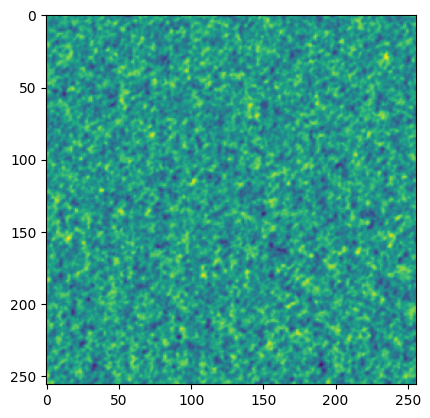

Step 10, Total loss 0.260692


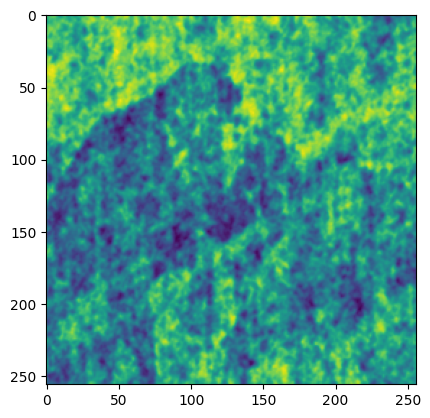

Step 20, Total loss 0.081891


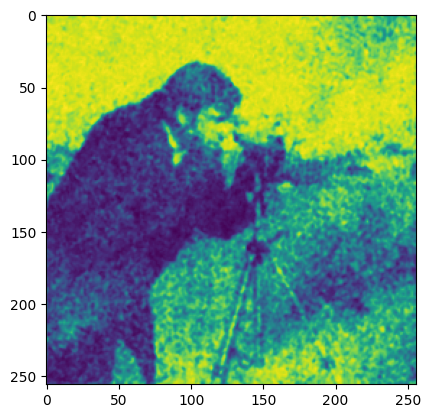

Step 30, Total loss 0.015210


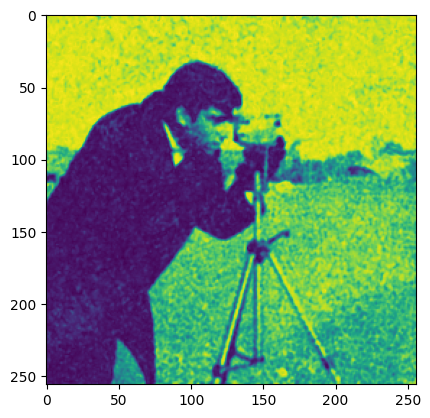

Step 40, Total loss 0.006940


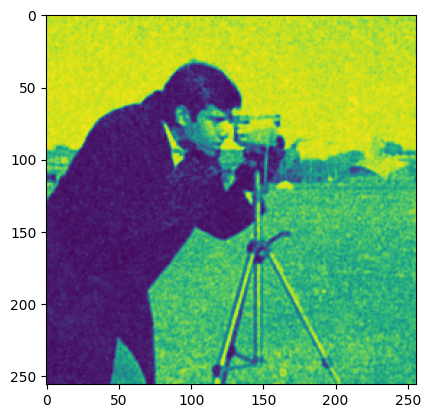

Step 50, Total loss 0.003722


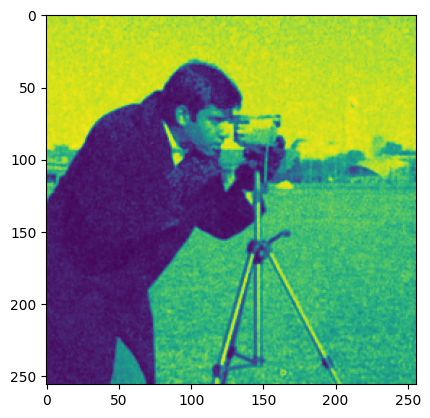

Step 60, Total loss 0.002225


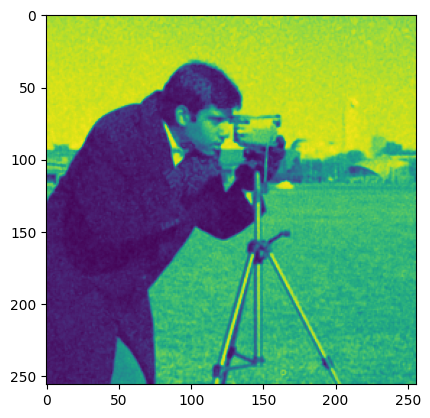

Step 70, Total loss 0.001458


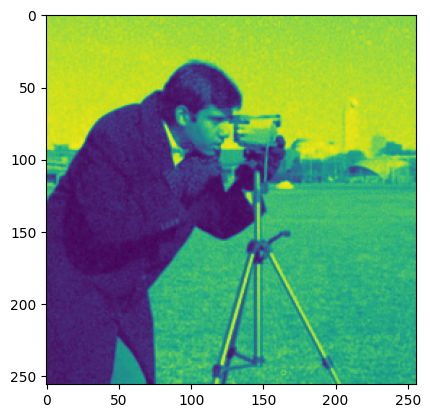

Step 80, Total loss 0.001032


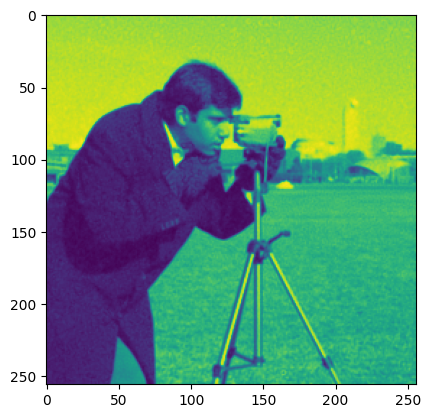

Step 90, Total loss 0.000912


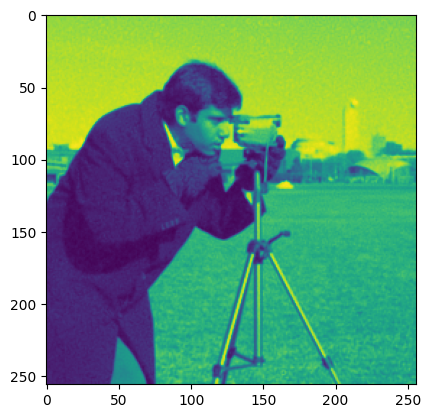

Step 100, Total loss 0.000917


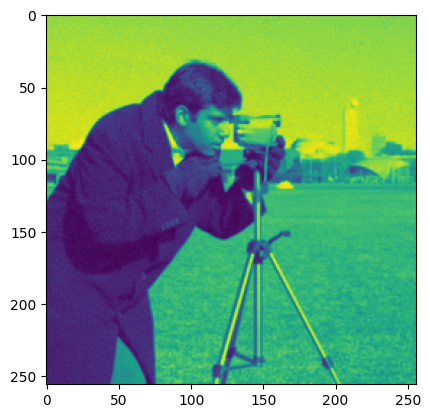

Step 110, Total loss 0.000531


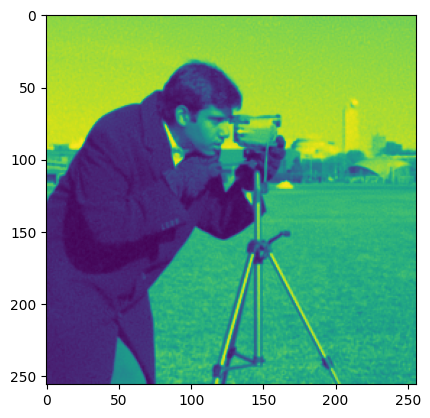

Step 120, Total loss 0.000473


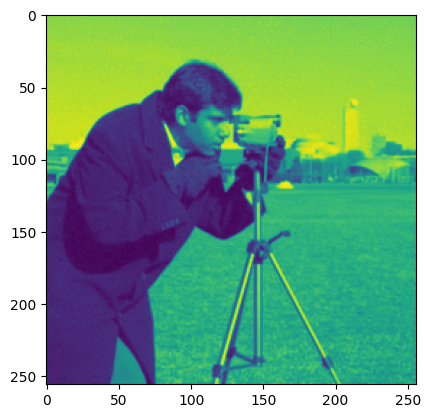

Step 130, Total loss 0.000369


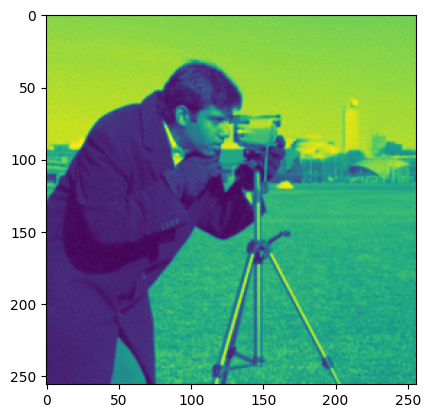

Step 140, Total loss 0.000306


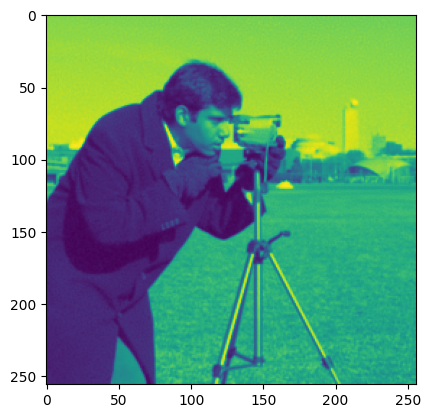

Step 150, Total loss 0.000266


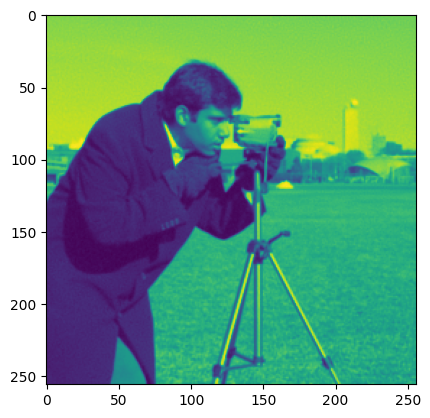

Step 160, Total loss 0.000255


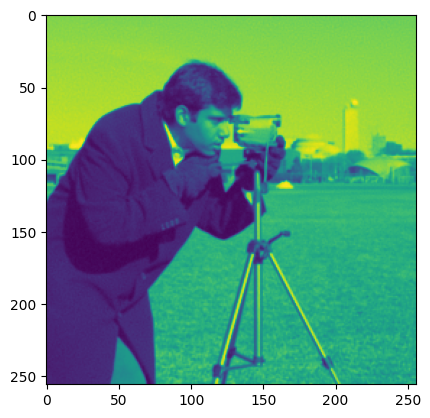

Step 170, Total loss 0.000684


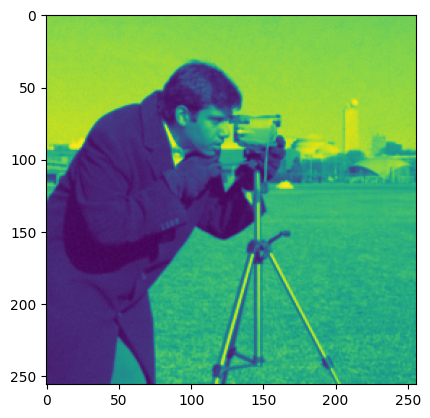

Step 180, Total loss 0.000191


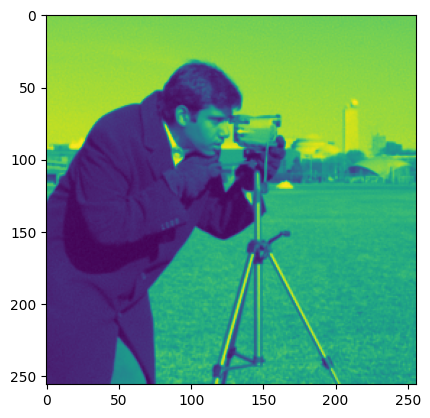

Step 190, Total loss 0.000243


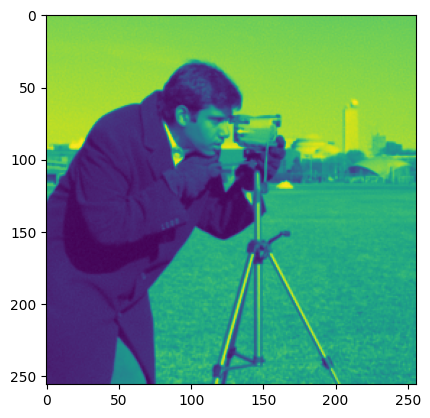

Step 200, Total loss 0.000170


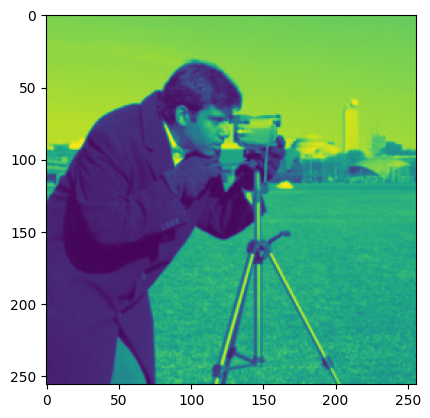

Step 210, Total loss 0.000137


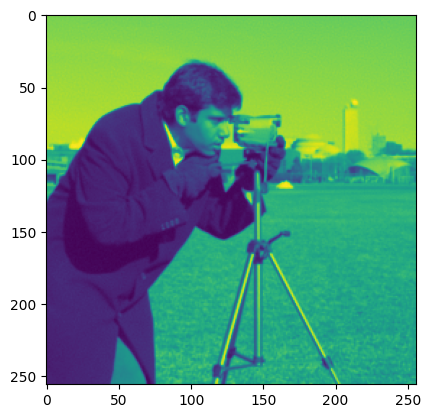

Step 220, Total loss 0.000125


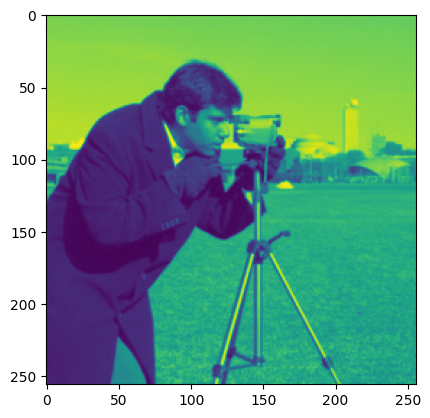

Step 230, Total loss 0.000110


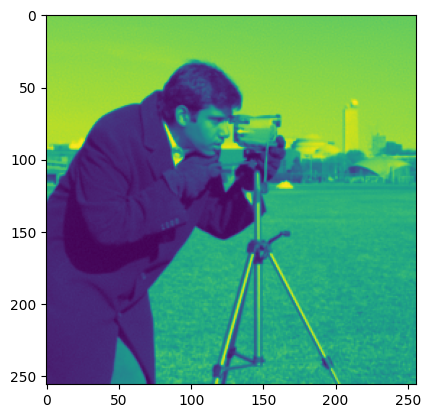

Step 240, Total loss 0.000100


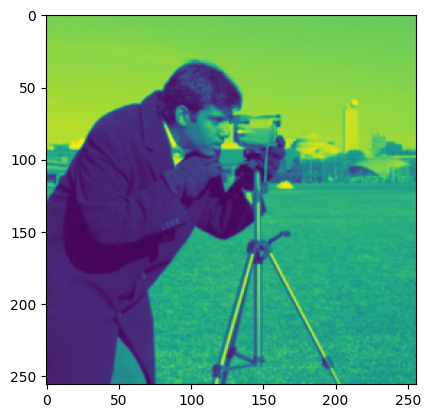

Step 250, Total loss 0.000097


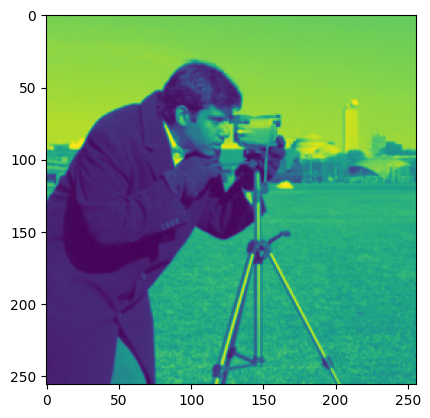

Step 260, Total loss 0.000696


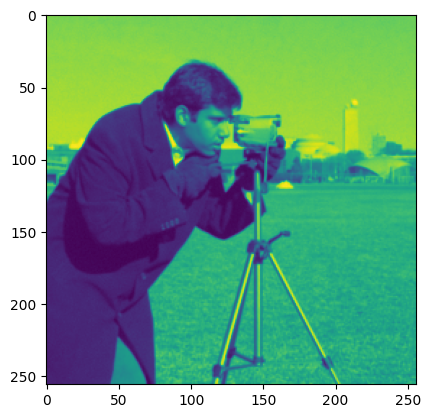

Step 270, Total loss 0.000162


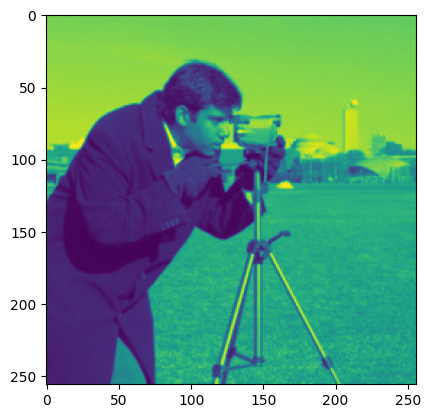

Step 280, Total loss 0.000190


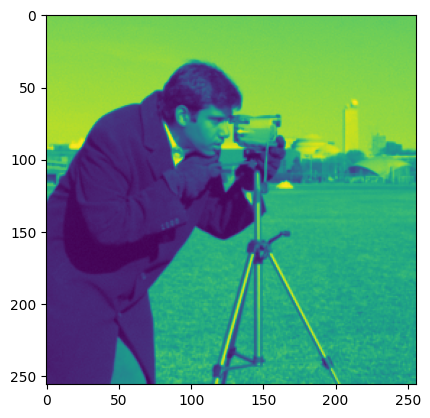

Step 290, Total loss 0.000084


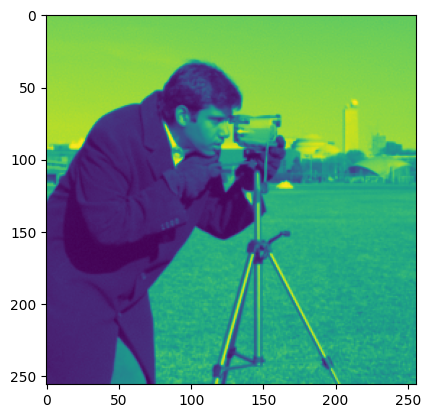

Step 300, Total loss 0.000077


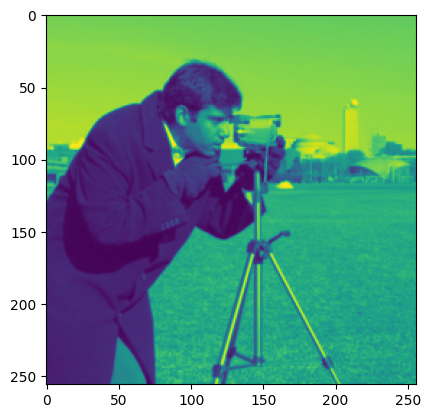

Step 310, Total loss 0.000068


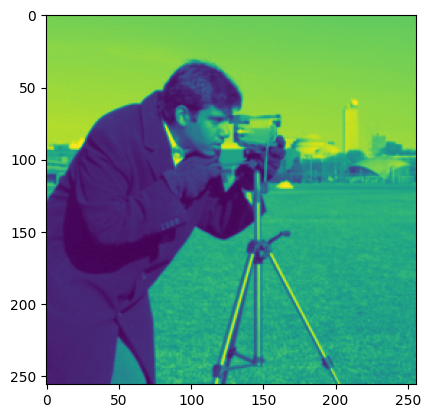

Step 320, Total loss 0.000059


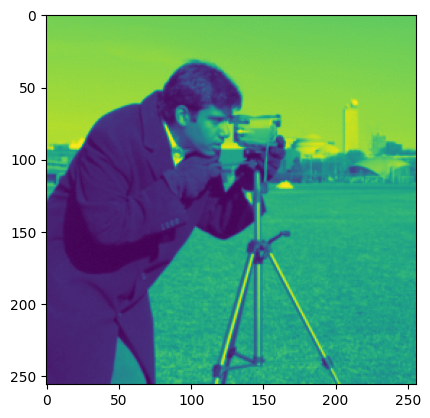

Step 330, Total loss 0.000053


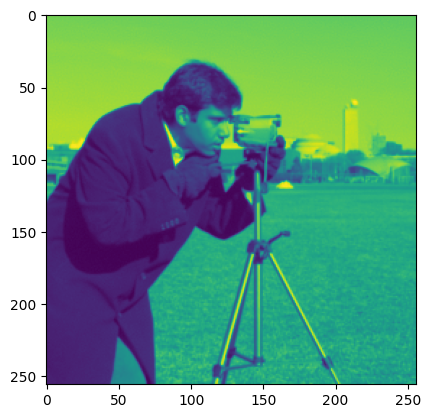

Step 340, Total loss 0.000048


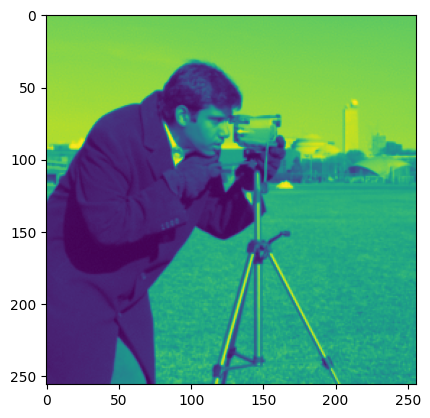

Step 350, Total loss 0.000045


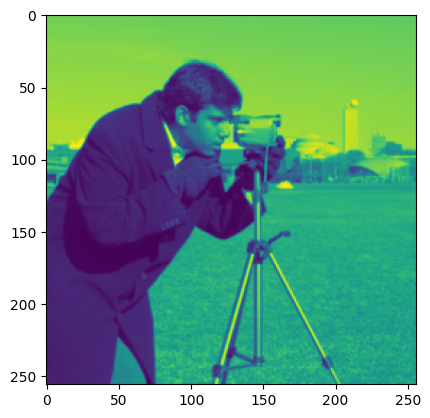

Step 360, Total loss 0.000042


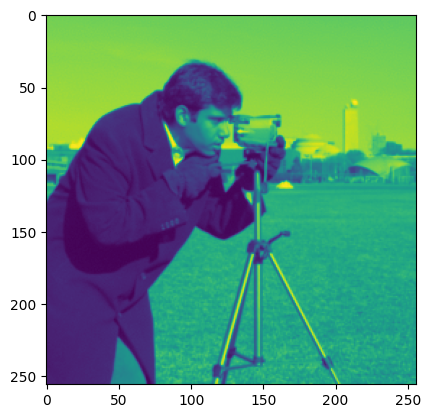

Step 370, Total loss 0.000040


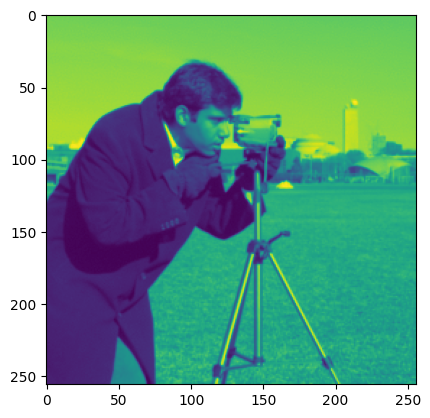

Step 380, Total loss 0.000053


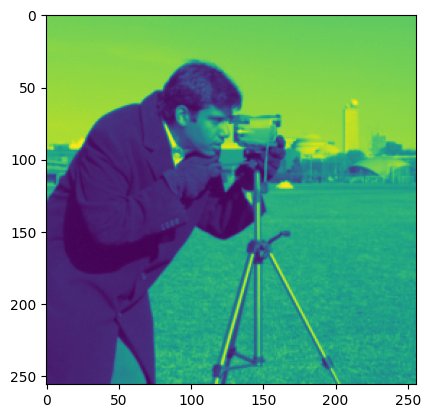

Step 390, Total loss 0.001363


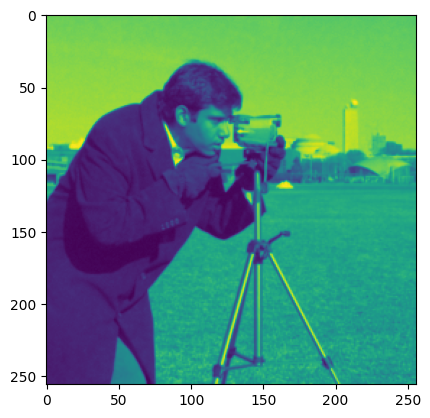

Step 400, Total loss 0.000111


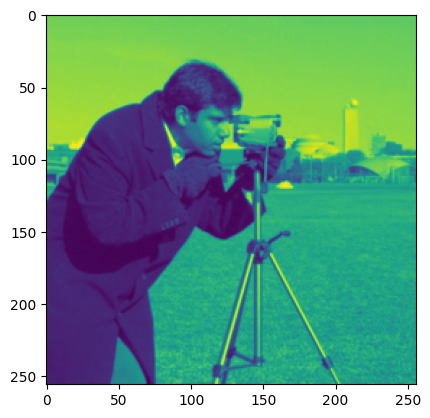

Step 410, Total loss 0.000144


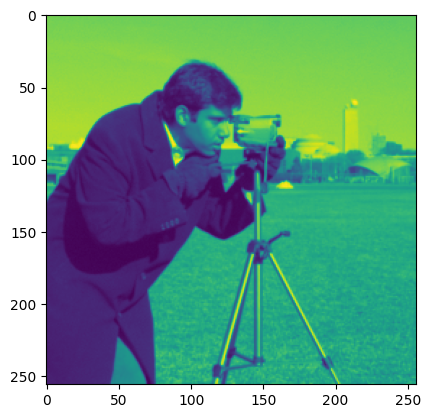

Step 420, Total loss 0.000076


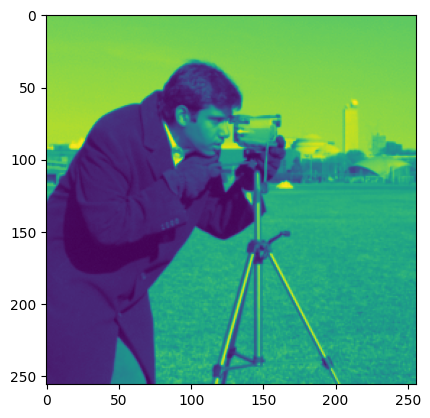

Step 430, Total loss 0.000038


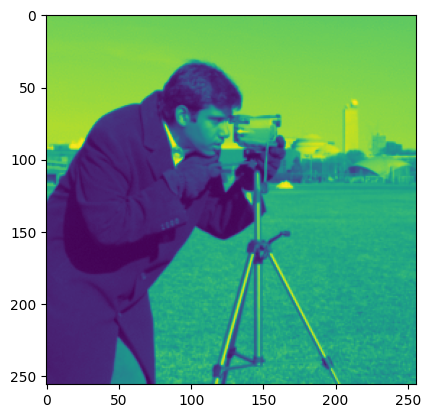

Step 440, Total loss 0.000030


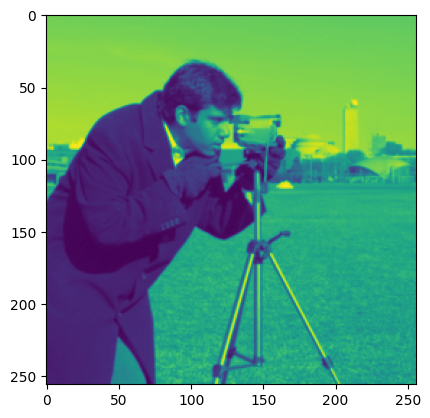

Step 450, Total loss 0.000028


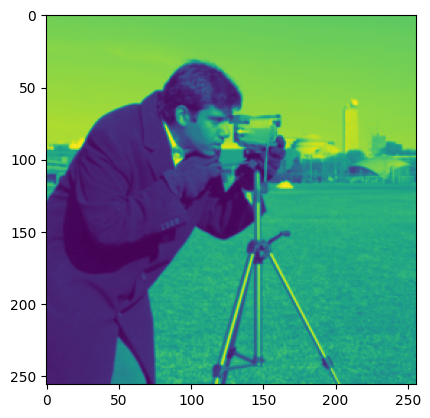

Step 460, Total loss 0.000026


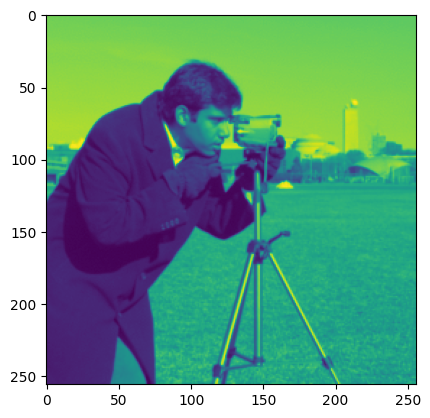

Step 470, Total loss 0.000024


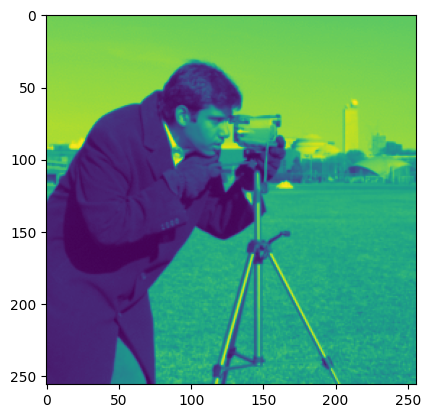

Step 480, Total loss 0.000022


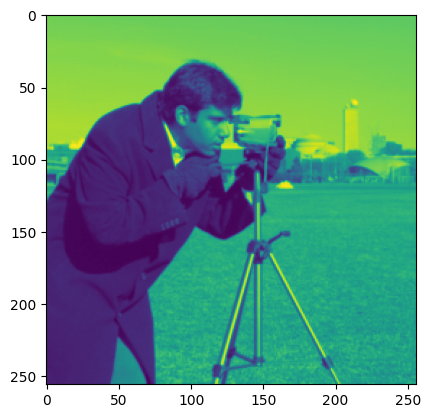

Step 490, Total loss 0.000021


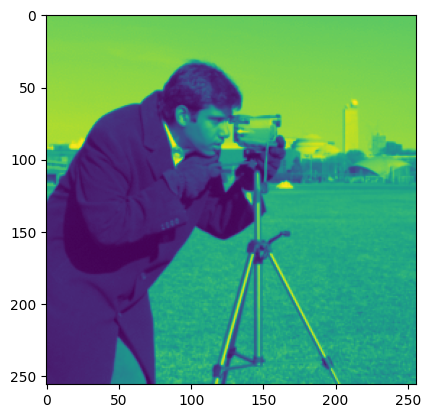

Step 499, Total loss 0.000020


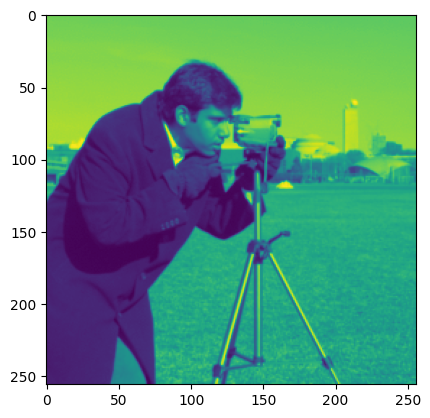

In [28]:
losses['ffn_siren'], outputs['ffn_siren'] = train(ffn_siren, "ffn_siren", dataloader, total_steps, steps_til_summary)

Step 0, Total loss 0.327822


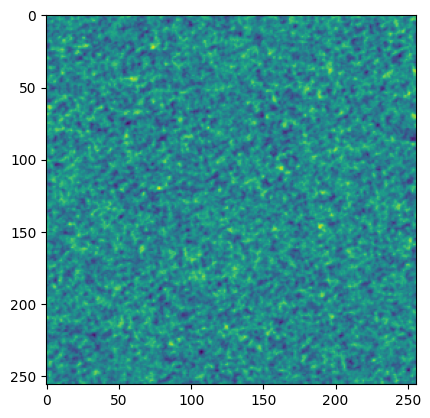

Step 10, Total loss 0.320707


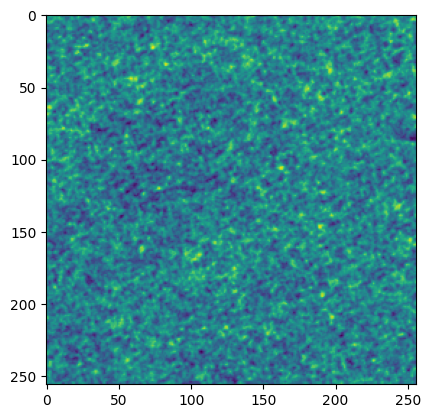

Step 20, Total loss 0.315272


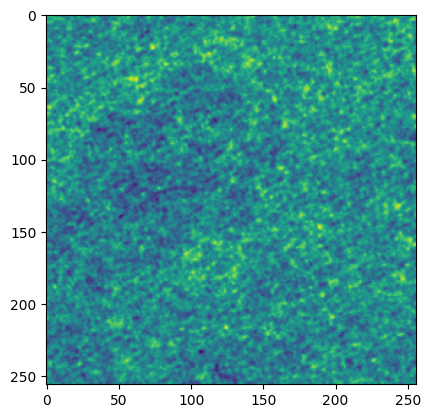

Step 30, Total loss 0.307486


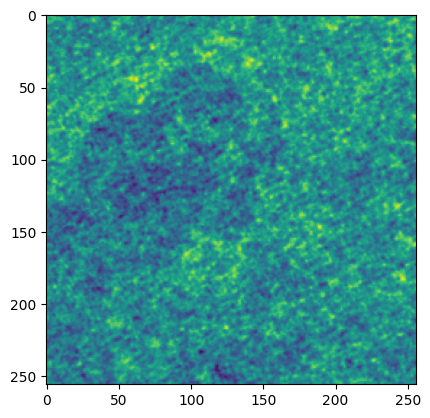

Step 40, Total loss 0.294117


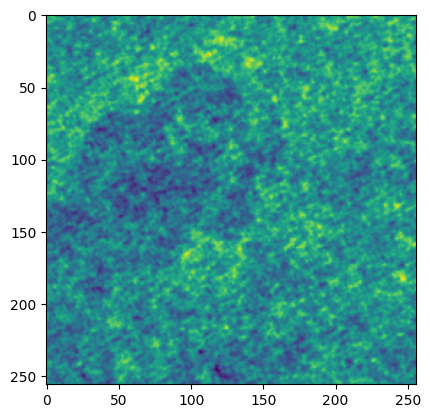

Step 50, Total loss 0.271018


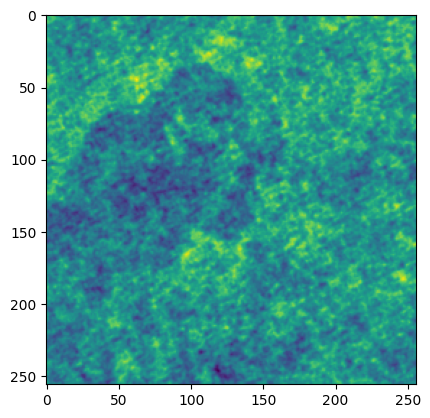

Step 60, Total loss 0.234900


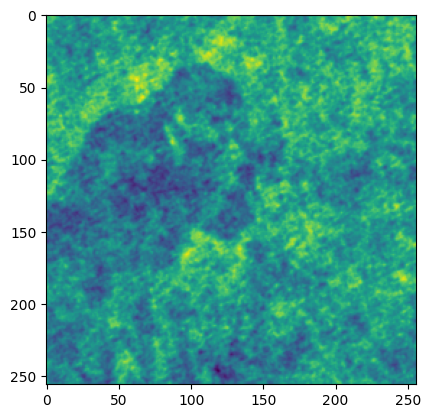

Step 70, Total loss 0.186876


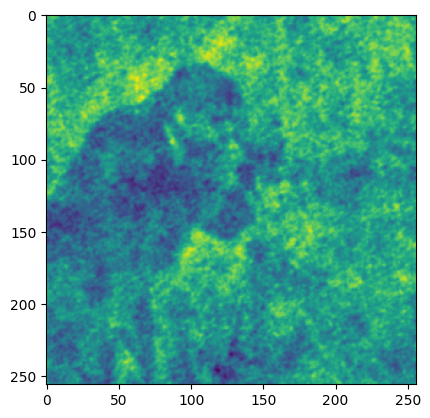

Step 80, Total loss 0.131915


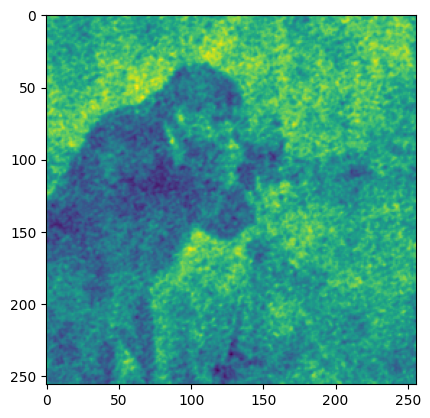

Step 90, Total loss 0.079491


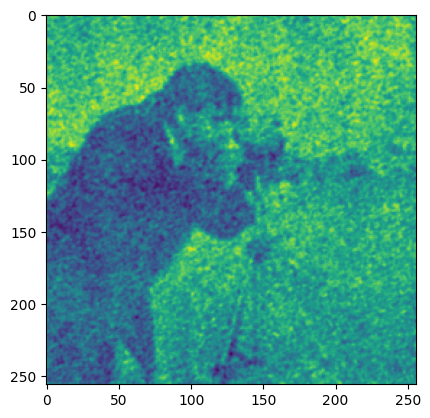

Step 100, Total loss 0.045525


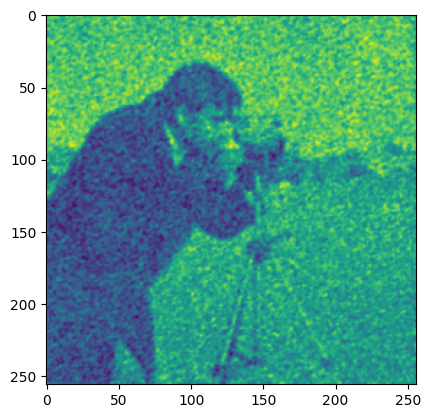

Step 110, Total loss 0.028638


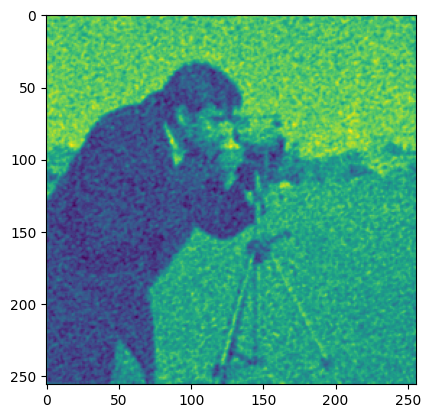

Step 120, Total loss 0.018926


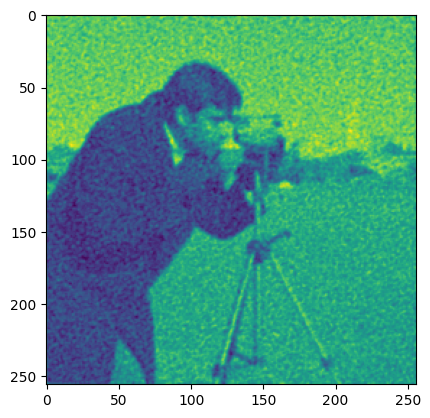

Step 130, Total loss 0.013622


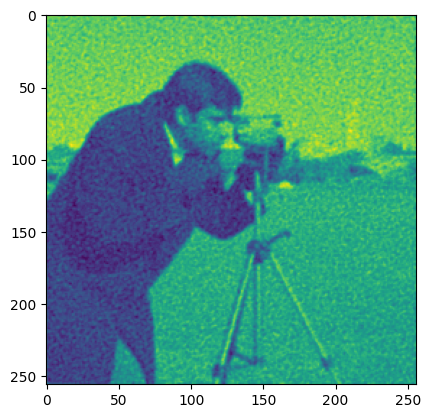

Step 140, Total loss 0.010433


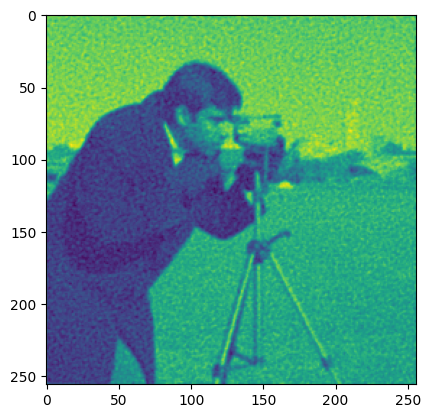

Step 150, Total loss 0.008358


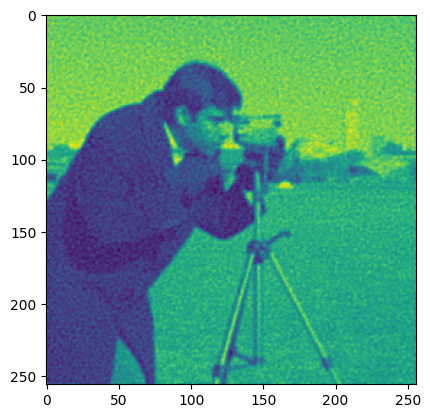

Step 160, Total loss 0.006924


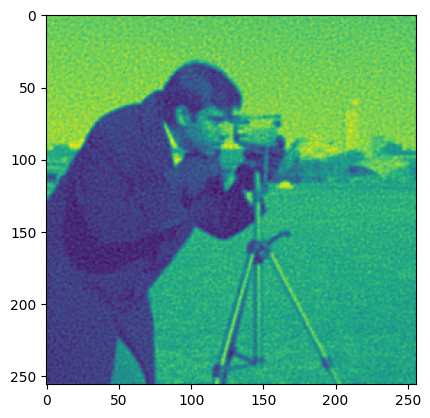

Step 170, Total loss 0.005877


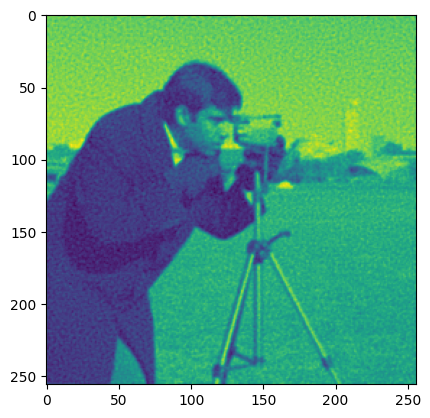

Step 180, Total loss 0.005082


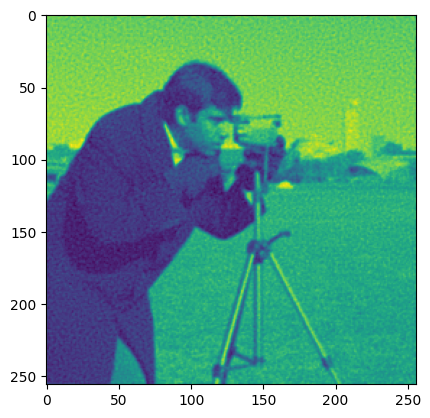

Step 190, Total loss 0.004459


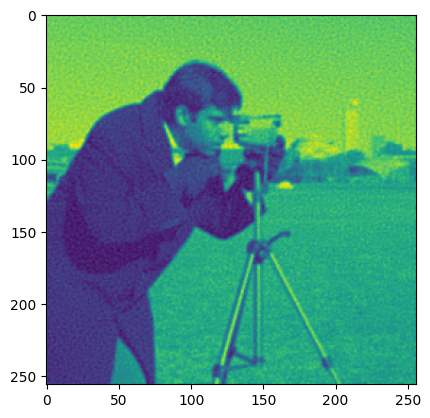

Step 200, Total loss 0.003958


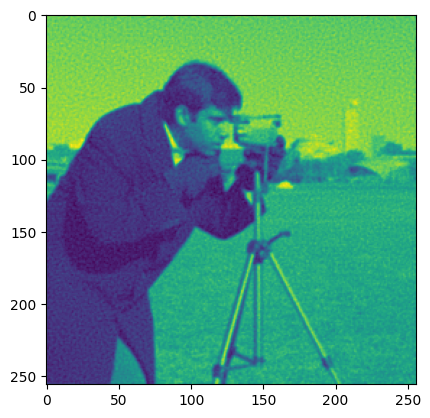

Step 210, Total loss 0.003546


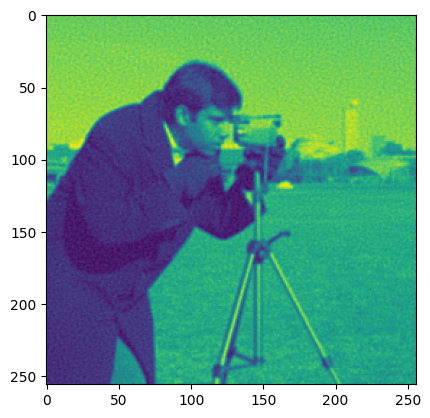

Step 220, Total loss 0.003203


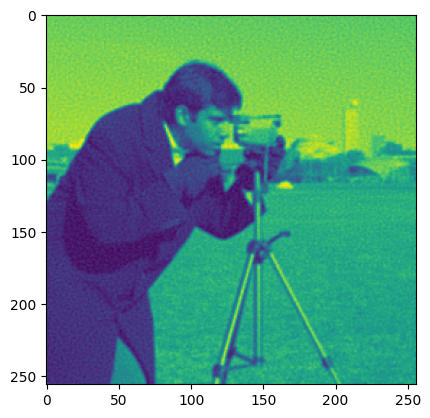

Step 230, Total loss 0.002913


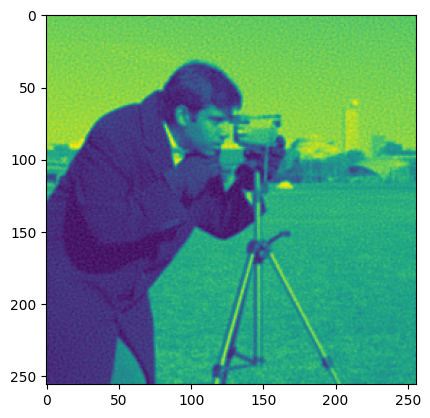

Step 240, Total loss 0.002673


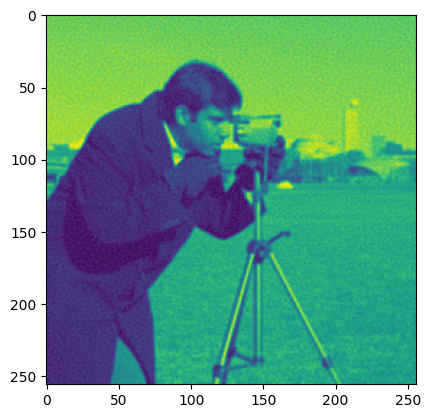

Step 250, Total loss 0.002454


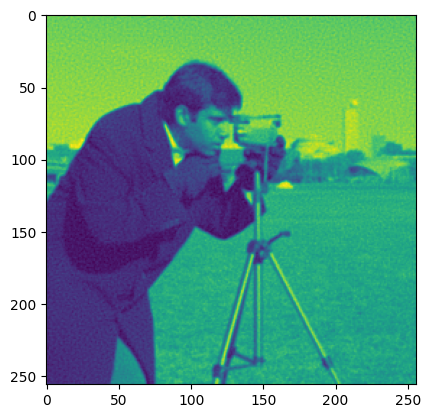

Step 260, Total loss 0.002273


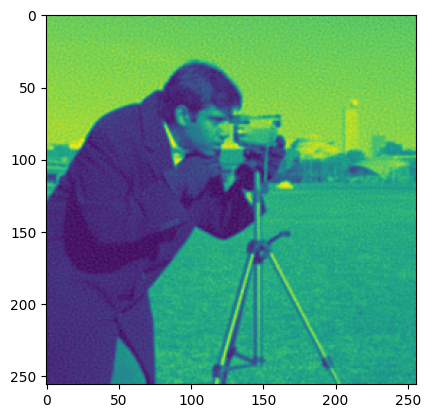

Step 270, Total loss 0.002107


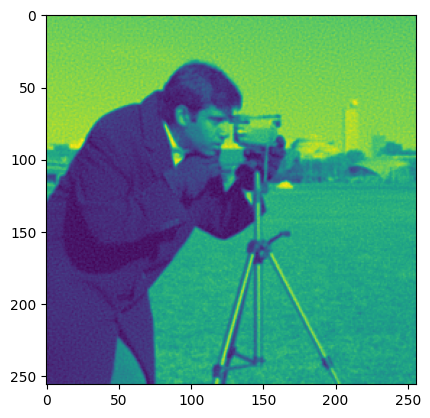

Step 280, Total loss 0.001960


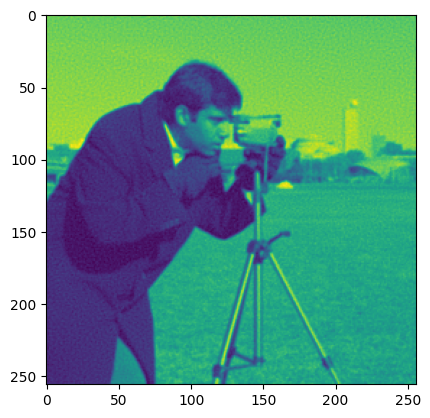

Step 290, Total loss 0.001830


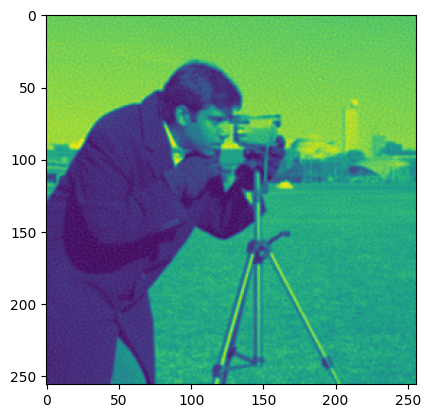

Step 300, Total loss 0.001713


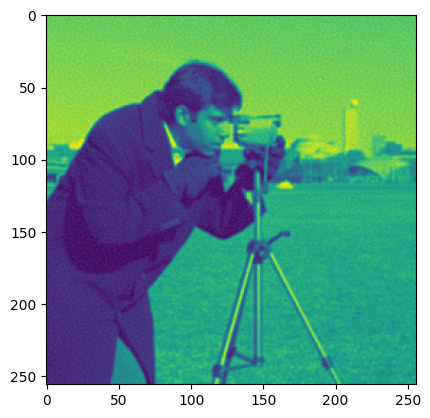

Step 310, Total loss 0.001608


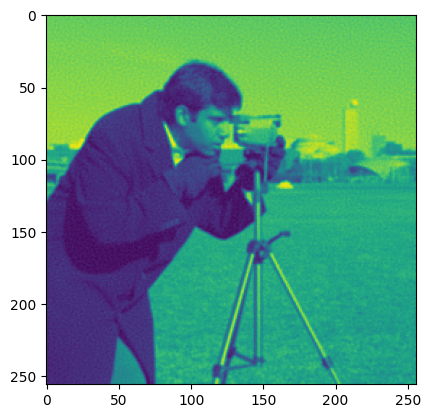

Step 320, Total loss 0.001512


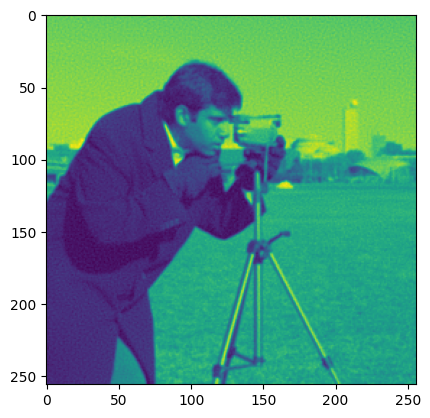

Step 330, Total loss 0.001424


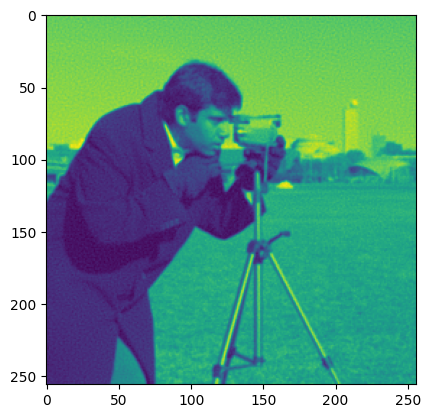

Step 340, Total loss 0.001344


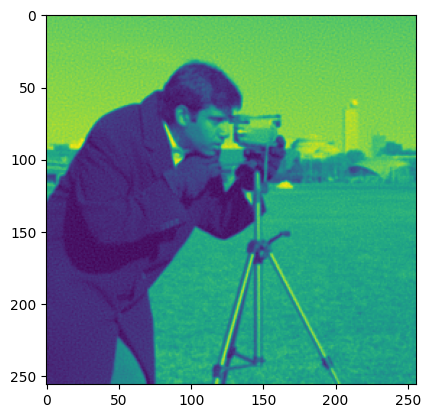

Step 350, Total loss 0.001272


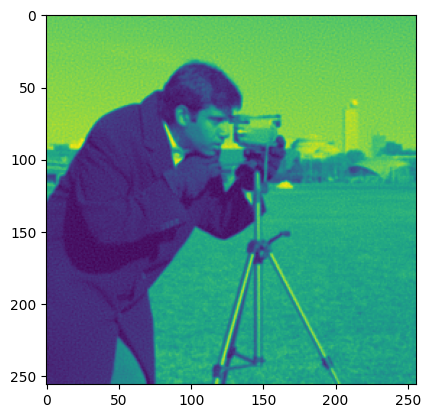

Step 360, Total loss 0.001272


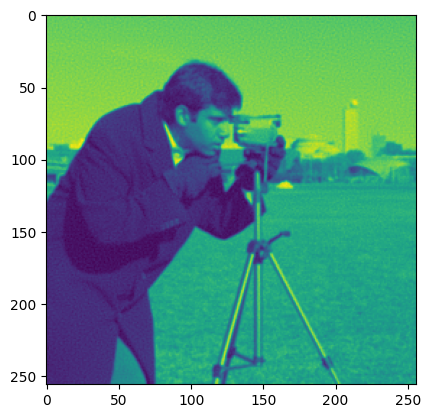

Step 370, Total loss 0.001160


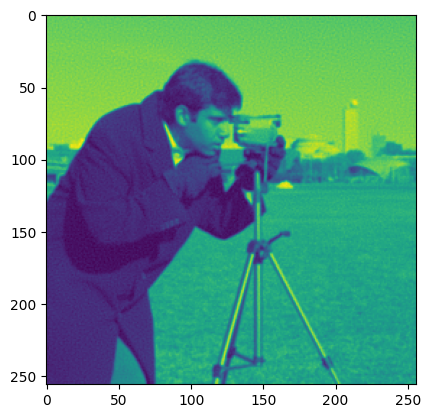

Step 380, Total loss 0.001092


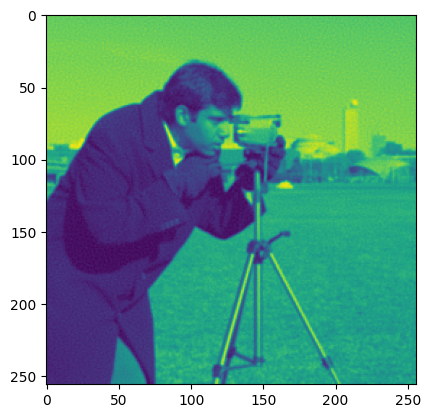

Step 390, Total loss 0.001035


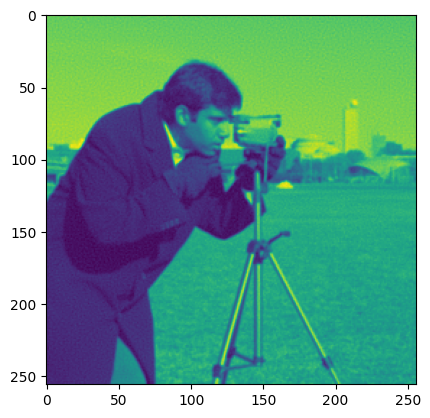

Step 400, Total loss 0.000984


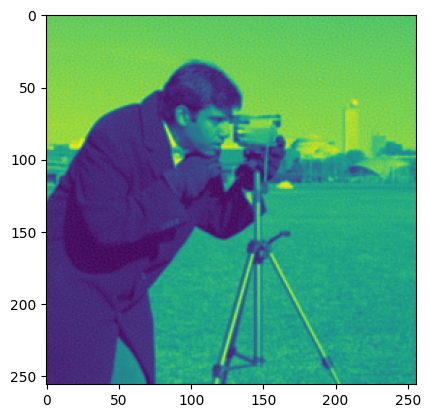

Step 410, Total loss 0.000938


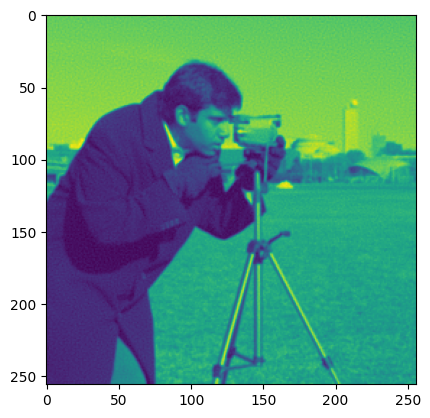

Step 420, Total loss 0.000895


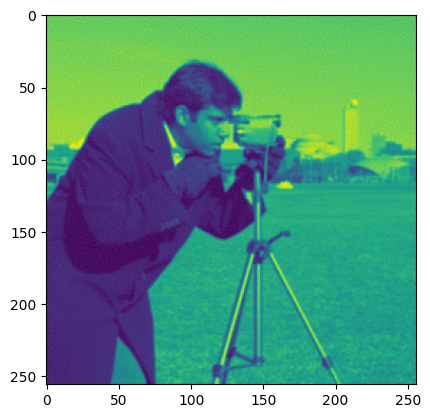

Step 430, Total loss 0.000855


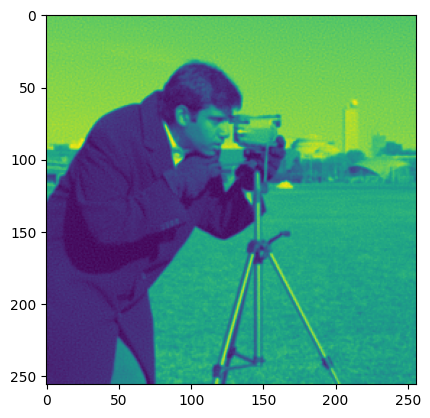

Step 440, Total loss 0.000818


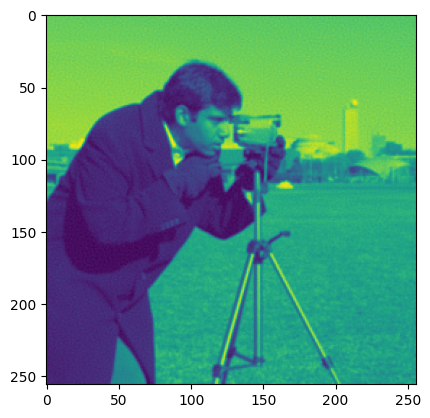

Step 450, Total loss 0.000783


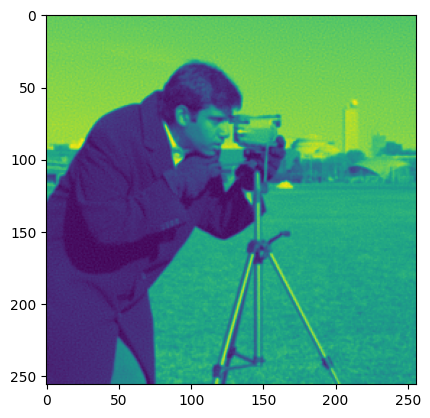

Step 460, Total loss 0.000750


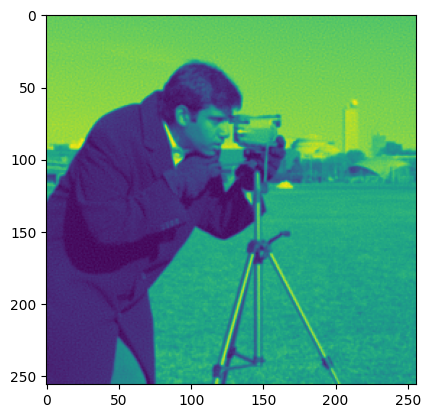

Step 470, Total loss 0.000724


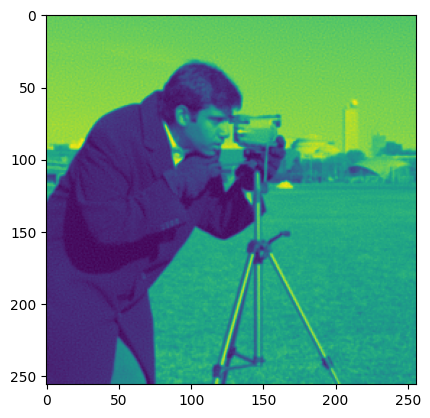

Step 480, Total loss 0.000693


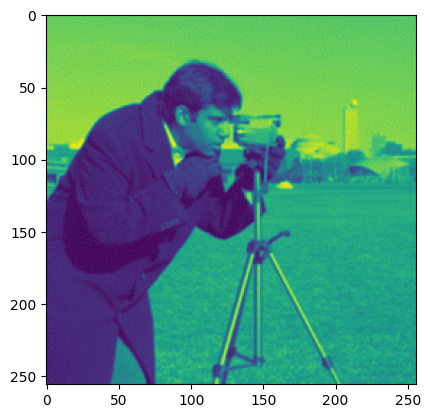

Step 490, Total loss 0.000677


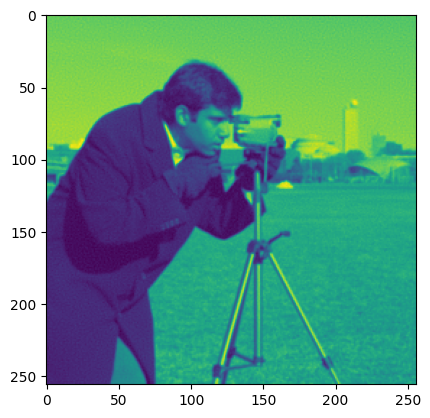

Step 499, Total loss 0.000642


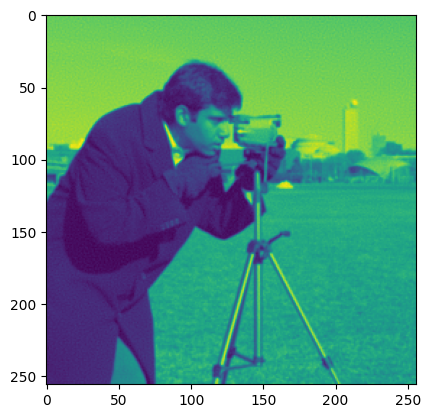

In [39]:
losses['ffn'], outputs['ffn'] = train(ffn, "ffn", dataloader, total_steps, steps_til_summary)

Step 0, Total loss 0.325285


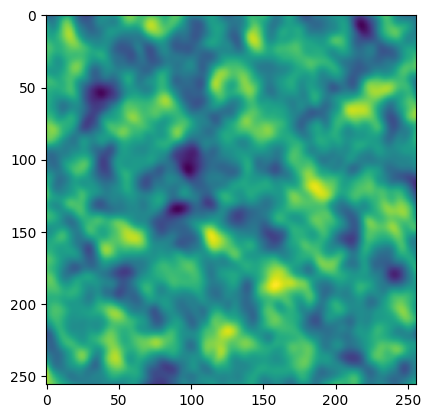

Step 10, Total loss 0.046095


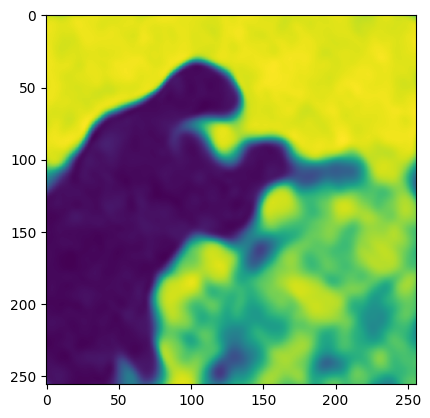

Step 20, Total loss 0.020861


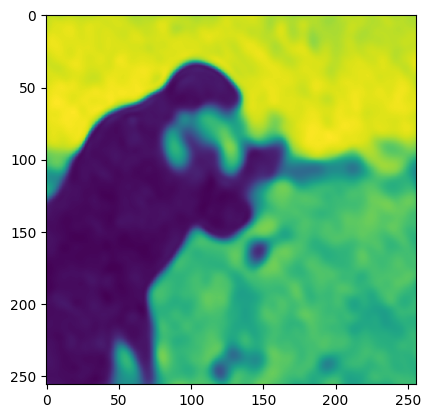

Step 30, Total loss 0.015311


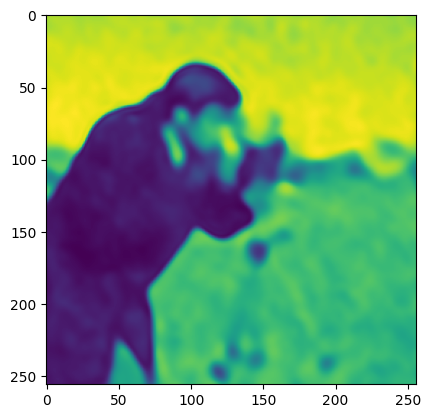

Step 40, Total loss 0.012187


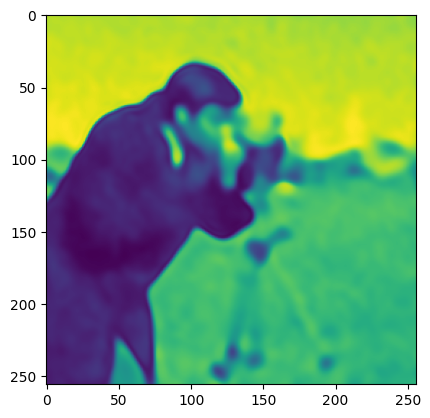

Step 50, Total loss 0.010447


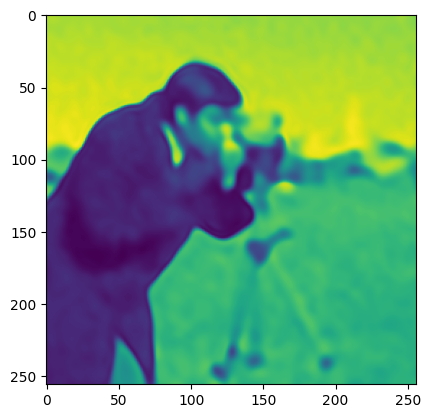

Step 60, Total loss 0.009226


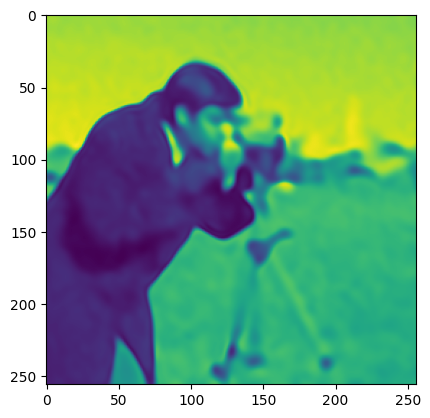

Step 70, Total loss 0.008319


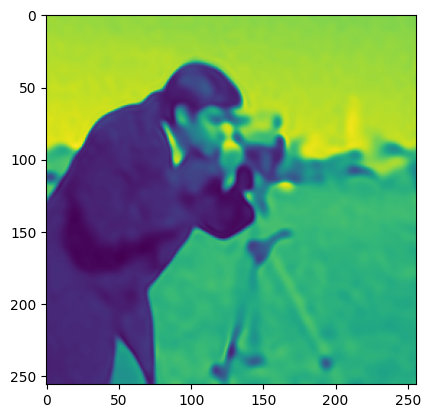

Step 80, Total loss 0.007574


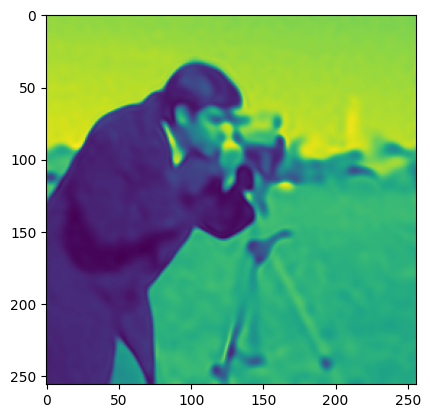

Step 90, Total loss 0.006935


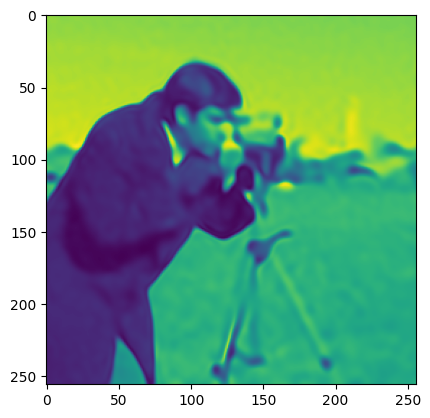

Step 100, Total loss 0.006366


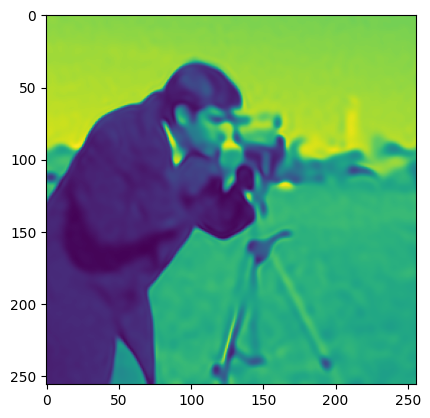

Step 110, Total loss 0.005834


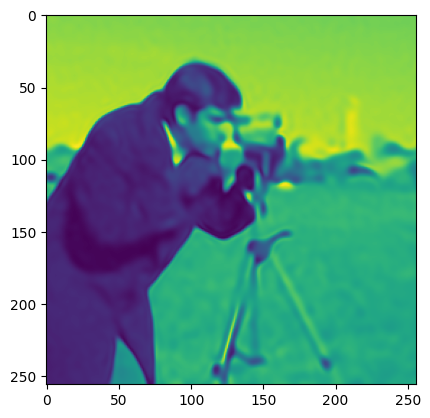

Step 120, Total loss 0.005336


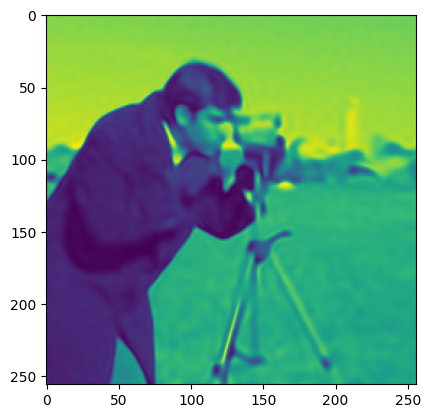

Step 130, Total loss 0.004861


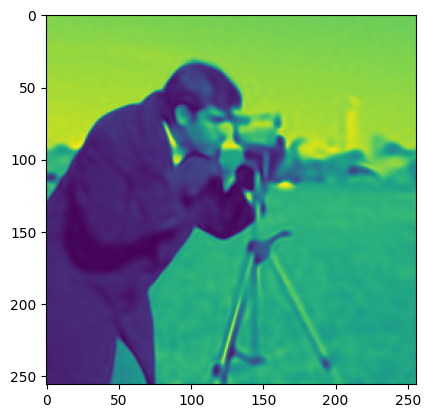

Step 140, Total loss 0.004394


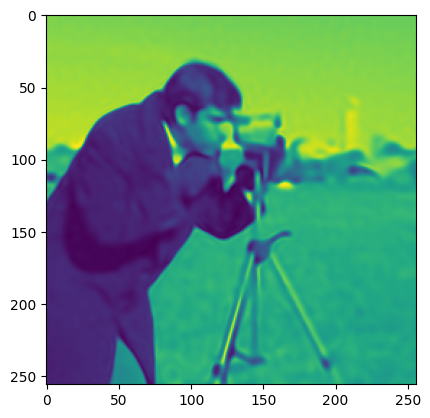

Step 150, Total loss 0.003926


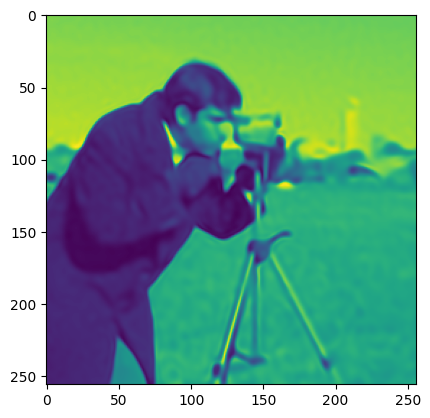

Step 160, Total loss 0.003958


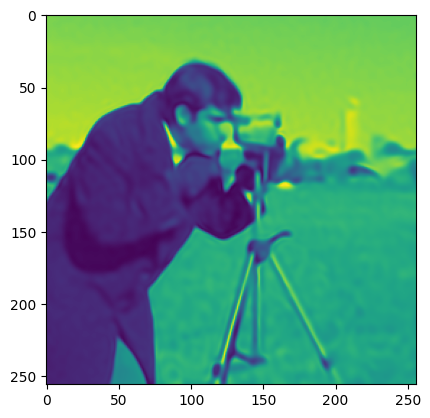

Step 170, Total loss 0.003149


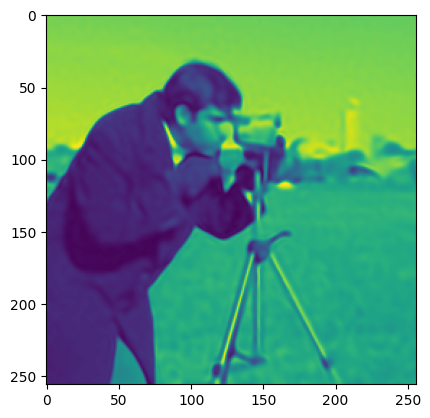

Step 180, Total loss 0.002831


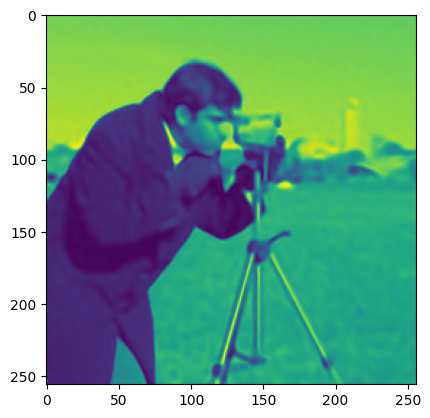

Step 190, Total loss 0.002582


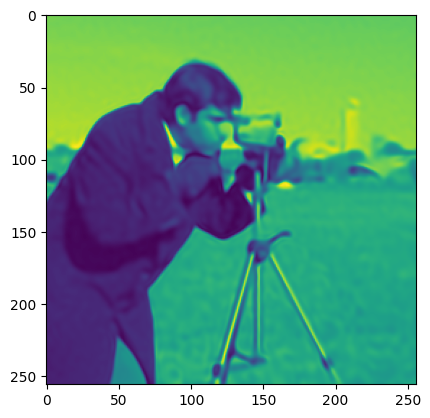

Step 200, Total loss 0.002400


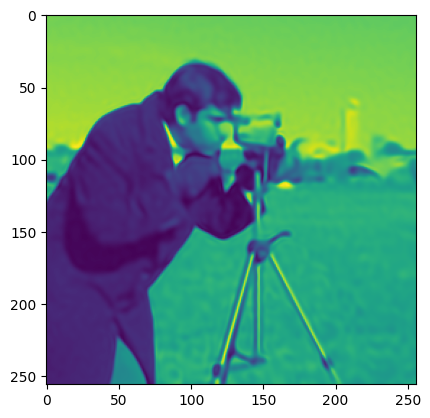

Step 210, Total loss 0.002242


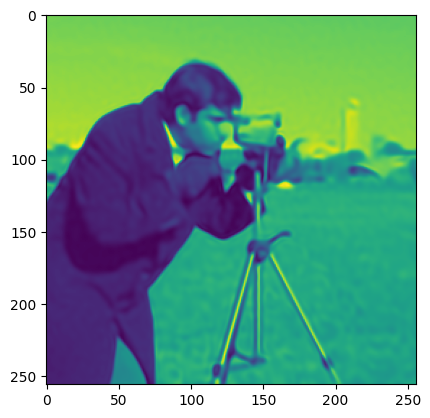

Step 220, Total loss 0.002111


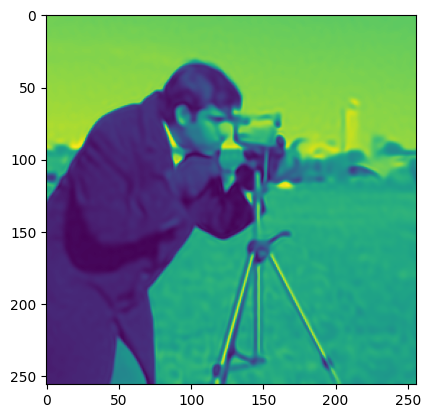

Step 230, Total loss 0.001995


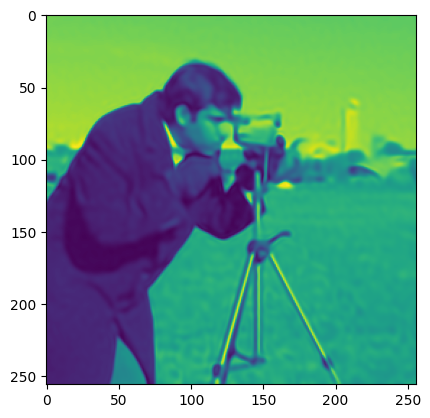

Step 240, Total loss 0.001891


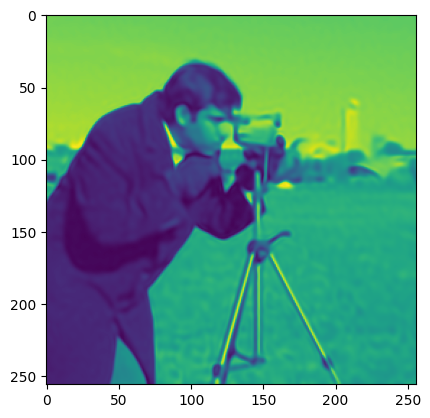

Step 250, Total loss 0.001821


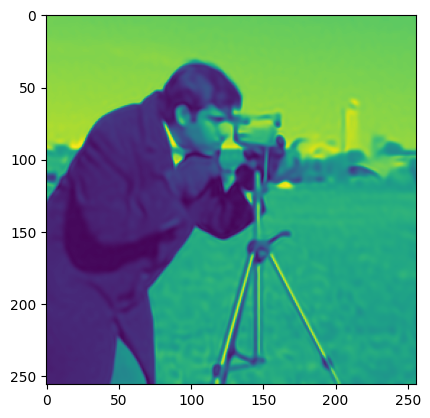

Step 260, Total loss 0.001921


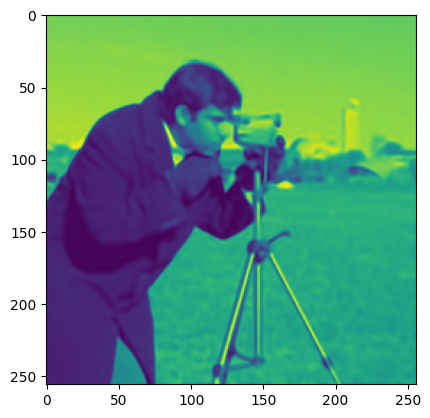

Step 270, Total loss 0.001651


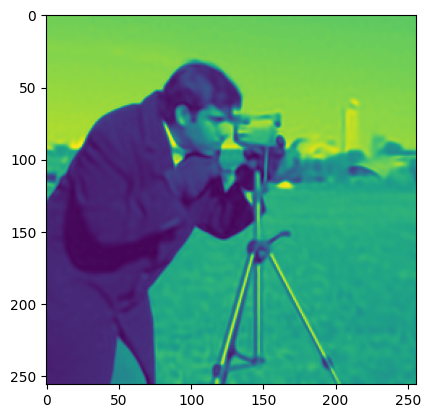

Step 280, Total loss 0.001576


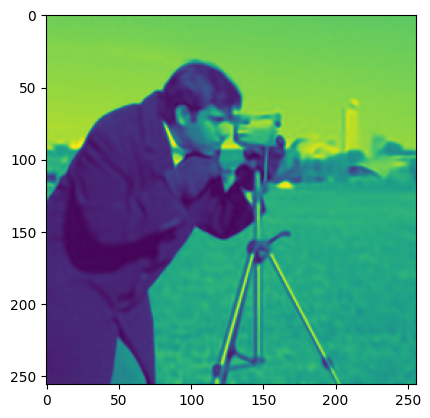

Step 290, Total loss 0.001511


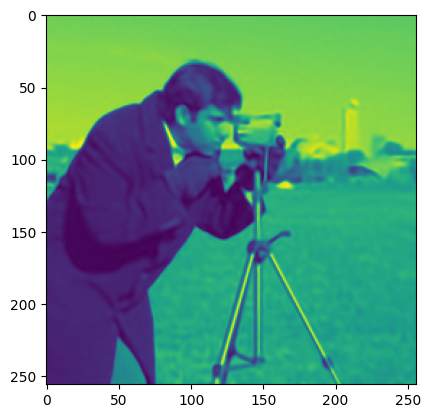

Step 300, Total loss 0.001454


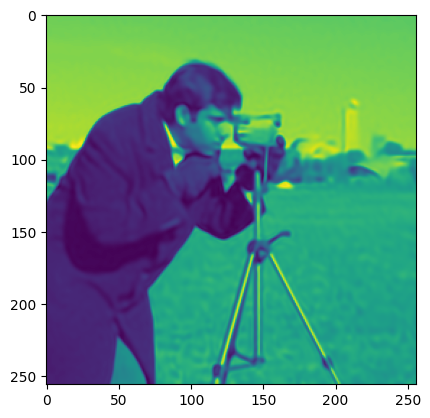

Step 310, Total loss 0.001397


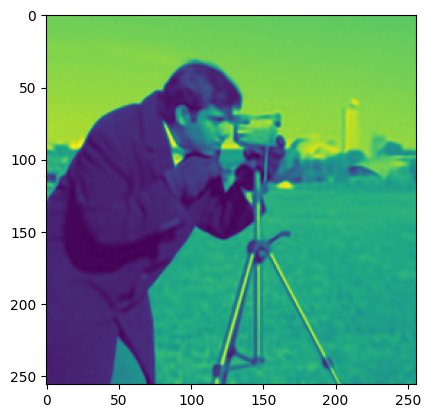

Step 320, Total loss 0.001347


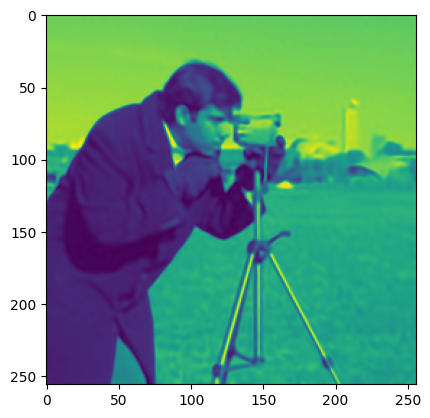

Step 330, Total loss 0.001301


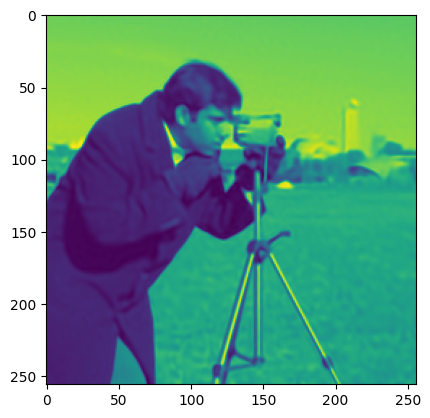

Step 340, Total loss 0.001258


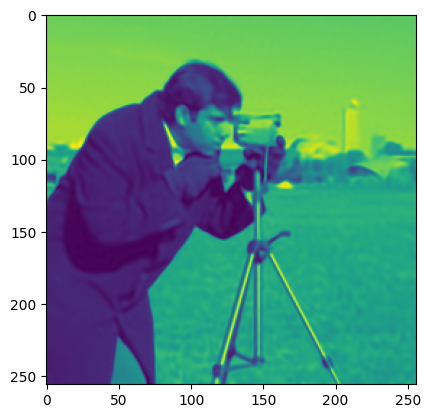

Step 350, Total loss 0.001218


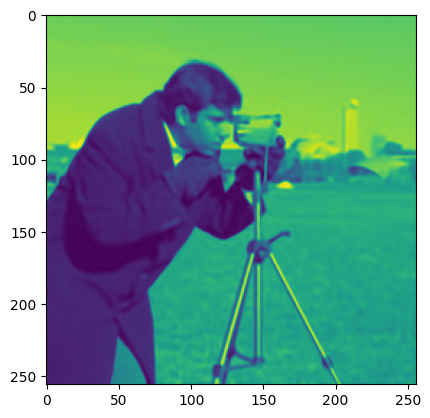

Step 360, Total loss 0.001181


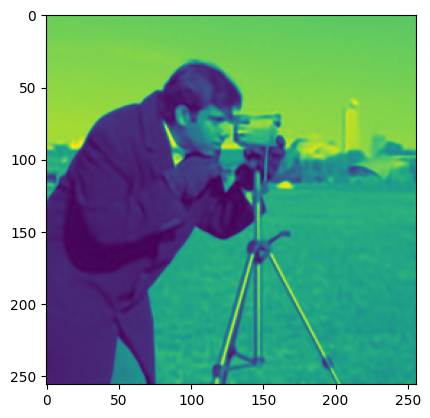

Step 370, Total loss 0.001146


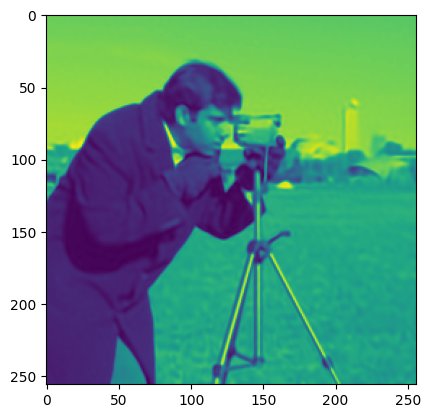

Step 380, Total loss 0.001113


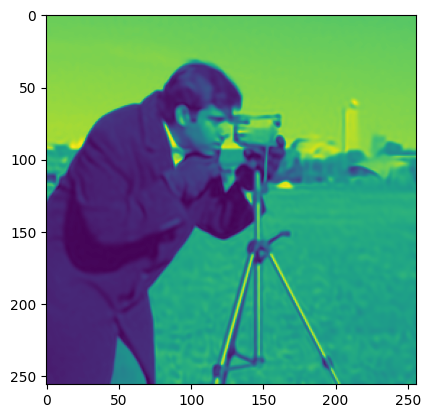

Step 390, Total loss 0.001170


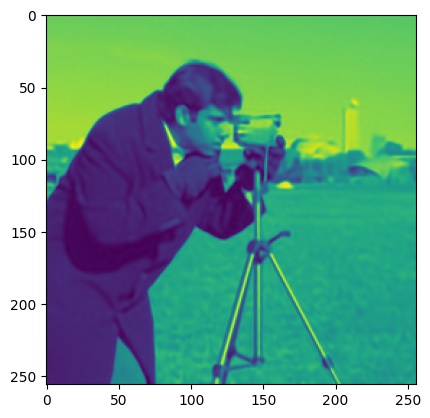

Step 400, Total loss 0.001355


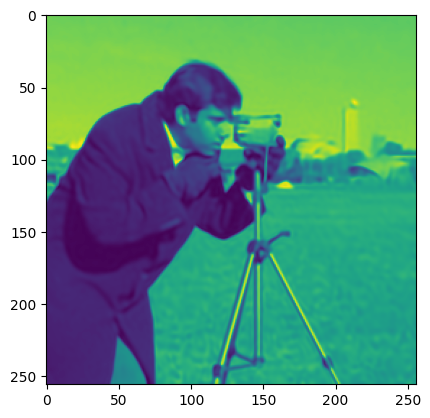

Step 410, Total loss 0.001086


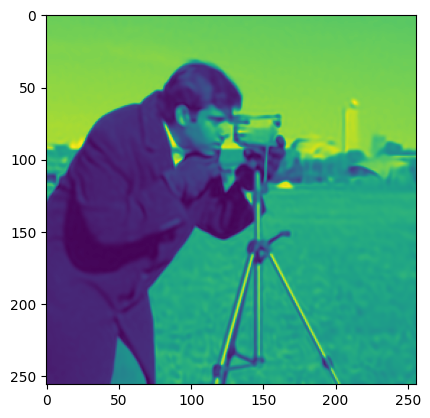

Step 420, Total loss 0.001021


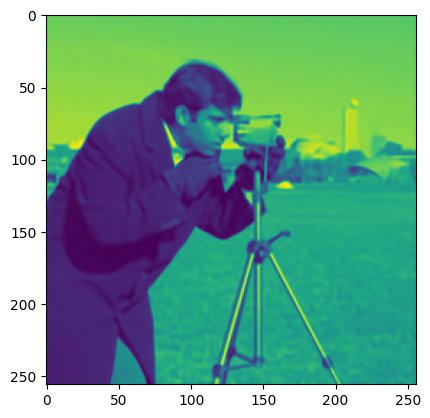

Step 430, Total loss 0.000987


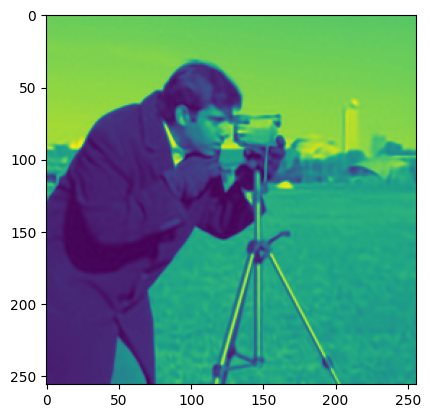

Step 440, Total loss 0.000960


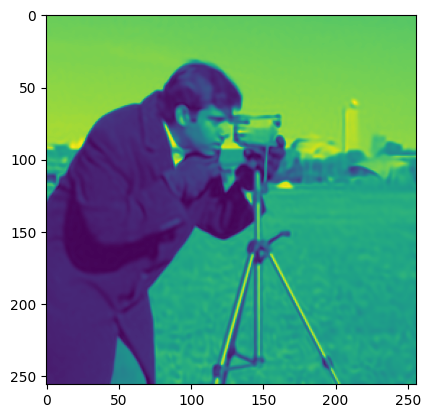

Step 450, Total loss 0.000934


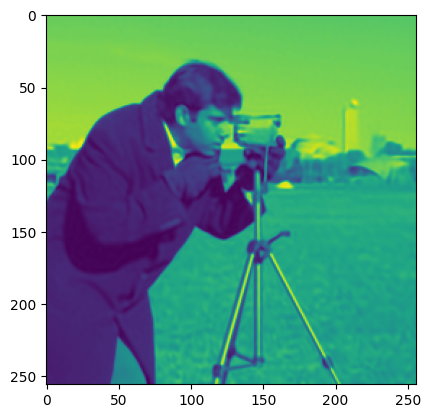

Step 460, Total loss 0.000912


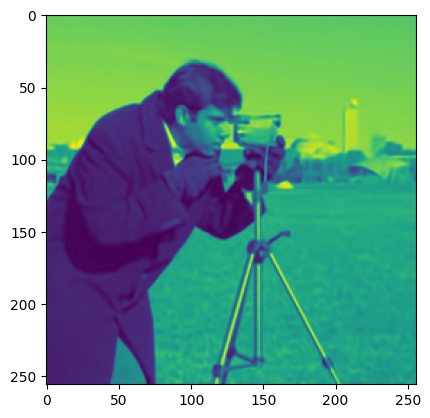

Step 470, Total loss 0.000891


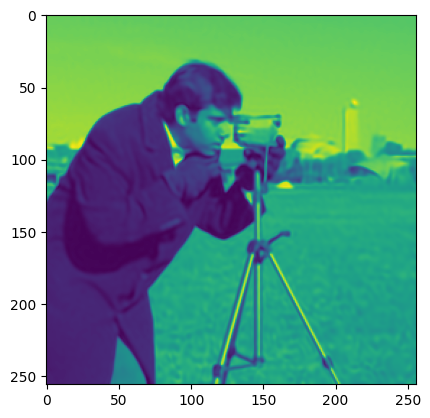

Step 480, Total loss 0.000871


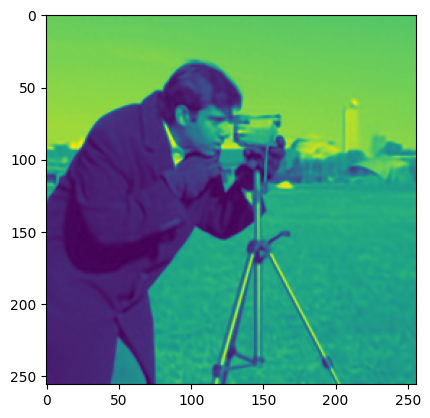

Step 490, Total loss 0.000852


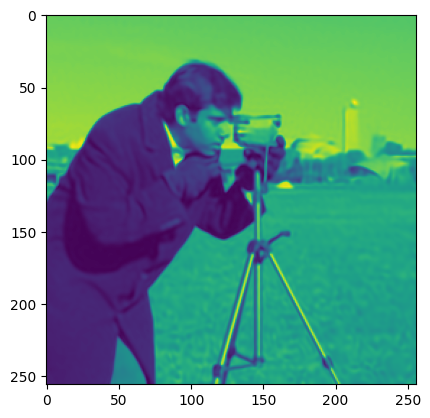

Step 499, Total loss 0.000835


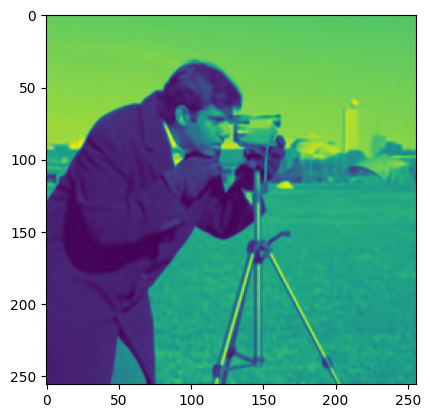

In [30]:
losses['siren'], outputs['siren'] = train(img_siren, "siren", dataloader, total_steps, steps_til_summary)

In [31]:
def loss_to_psnr(loss, max=2):
  return 10*np.log10(max**2/np.asarray(loss))


final loss:
ffn_siren: 1.9838658772641793e-05
ffn: 0.0006421204889193177
siren: 0.0008351427386514843


Text(0.5, 1.0, 'training loss')

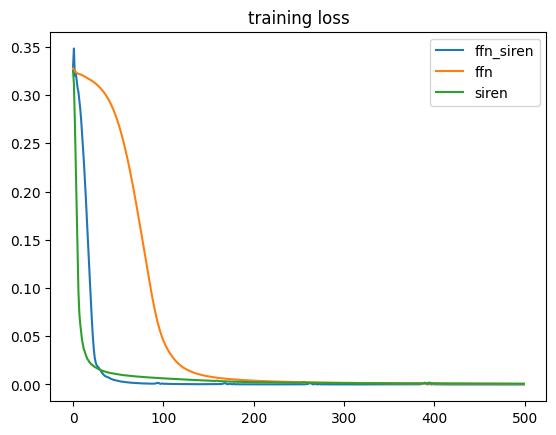

In [40]:
print("final loss:")

for n in losses:
  plt.plot(losses[n], label=n)
  plt.legend()
  print(f"{n}: {losses[n][-1]}")
plt.title("training loss")

Text(0.5, 1.0, 'PSNR')

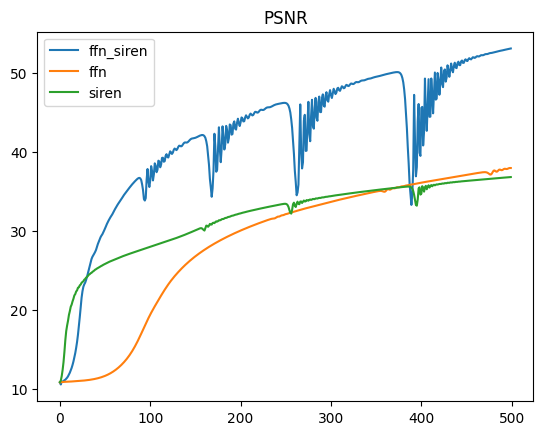

In [41]:
for n in losses:
  plt.plot(loss_to_psnr(losses[n]), label=n)
  plt.legend()
plt.title("PSNR")

In [34]:
!pip install imageio-ffmpeg
import os, imageio


Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [35]:
# Save out video
all_preds = np.concatenate([outputs[n] for n in outputs], axis=-1)
data8 = (255*(np.clip(all_preds, -1, 1)+1)/2).astype(np.uint8)
f = os.path.join('training_convergence.mp4')
imageio.mimwrite(f, data8, fps=20)
N=len(outputs)
# Display video inline
from IPython.display import HTML
from base64 import b64encode
mp4 = open(f, 'rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()

In [36]:
HTML(f'''
<video width=1000 controls autoplay loop>
      <source src="{data_url}" type="video/mp4">
</video>
<table width="1000" cellspacing="0" cellpadding="0">
  <tr>{''.join(N*[f'<td width="{1000//len(outputs)}"></td>'])}</tr>
  <tr>{''.join(N*['<td style="text-align:center">{}</td>'])}</tr>
</table>
'''.format(*list(outputs.keys())))

Text(0.5, 1.0, 'groundtruth')

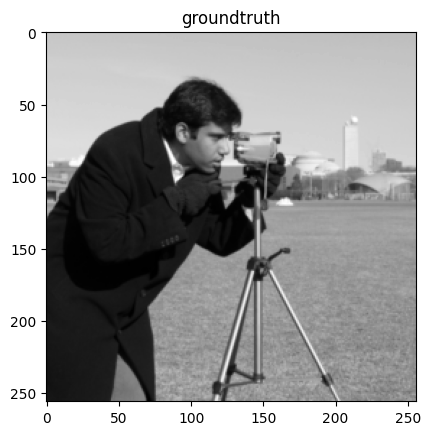

In [ ]:
plt.imshow((get_cameraman_tensor(256)+0.5)[0]*255, cmap='gray')
plt.title("groundtruth")

In [42]:
print(data_url)

data:video/mp4;base64,AAAAIGZ0eXBpc29tAAACAGlzb21pc28yYXZjMW1wNDEAAAAIZnJlZQACnd5tZGF0AAACrgYF//+q3EXpvebZSLeWLNgg2SPu73gyNjQgLSBjb3JlIDE1OSByMjk5MSAxNzcxYjU1IC0gSC4yNjQvTVBFRy00IEFWQyBjb2RlYyAtIENvcHlsZWZ0IDIwMDMtMjAxOSAtIGh0dHA6Ly93d3cudmlkZW9sYW4ub3JnL3gyNjQuaHRtbCAtIG9wdGlvbnM6IGNhYmFjPTEgcmVmPTMgZGVibG9jaz0xOjA6MCBhbmFseXNlPTB4MzoweDExMyBtZT1oZXggc3VibWU9NyBwc3k9MSBwc3lfcmQ9MS4wMDowLjAwIG1peGVkX3JlZj0xIG1lX3JhbmdlPTE2IGNocm9tYV9tZT0xIHRyZWxsaXM9MSA4eDhkY3Q9MSBjcW09MCBkZWFkem9uZT0yMSwxMSBmYXN0X3Bza2lwPTEgY2hyb21hX3FwX29mZnNldD0tMiB0aHJlYWRzPTMgbG9va2FoZWFkX3RocmVhZHM9MSBzbGljZWRfdGhyZWFkcz0wIG5yPTAgZGVjaW1hdGU9MSBpbnRlcmxhY2VkPTAgYmx1cmF5X2NvbXBhdD0wIGNvbnN0cmFpbmVkX2ludHJhPTAgYmZyYW1lcz0zIGJfcHlyYW1pZD0yIGJfYWRhcHQ9MSBiX2JpYXM9MCBkaXJlY3Q9MSB3ZWlnaHRiPTEgb3Blbl9nb3A9MCB3ZWlnaHRwPTIga2V5aW50PTI1MCBrZXlpbnRfbWluPTIwIHNjZW5lY3V0PTQwIGludHJhX3JlZnJlc2g9MCByY19sb29rYWhlYWQ9NDAgcmM9Y3JmIG1idHJlZT0xIGNyZj0yMy4wIHFjb21wPTAuNjAgcXBtaW49MCBxcG1heD02OSBxcHN0ZXA9NCBpcF9yYXRpbz0xLjQwIGFxPTE6MS